In [ ]:
!pip install --upgrade pandas_profiling --user

Requirement already up-to-date: pandas_profiling in /root/.local/lib/python3.6/site-packages (2.9.0)


In [ ]:
!pip install bds_courseware

In [ ]:
!pip install impyute

In [ ]:
import pandas as pd
import numpy as np
import scipy.stats as st
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn import preprocessing
import pandas_profiling
from google.colab import drive
from urllib.request import urlopen
%matplotlib inline
from sklearn.cluster import DBSCAN
from sklearn.ensemble import IsolationForest
from sklearn.decomposition import PCA, TruncatedSVD
from sklearn.preprocessing import MinMaxScaler, OneHotEncoder, LabelEncoder
from sklearn.manifold import TSNE
import umap
from bds_courseware import get_dataset
from bds_courseware.__ids import __datasets 
from bds_courseware._utils import _read_drive_data as read_data
from google.colab import drive
from sklearn.impute import SimpleImputer
from sklearn.impute import KNNImputer
from sklearn import metrics
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_error
from sklearn.linear_model import LinearRegression, Ridge, Lasso, ElasticNet
from pandas_profiling import ProfileReport
from sklearn.model_selection import train_test_split, cross_val_score, GridSearchCV, KFold, TimeSeriesSplit
from sklearn.pipeline import Pipeline, make_pipeline
from sklearn_pandas import DataFrameMapper, gen_features

/usr/local/lib/python3.6/dist-packages/statsmodels/tools/_testing.py:19: FutureWarning: pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.
  import pandas.util.testing as tm


In [ ]:
drive.mount('/content/gdrive')

Drive already mounted at /content/gdrive; to attempt to forcibly remount, call drive.mount("/content/gdrive", force_remount=True).


In [ ]:
SEED = 42
DESCRIPTION = f'/content/drive/My Drive/epam/Module4/data/data_description.txt'

#Auxilarity methods

In [ ]:
def linreg_scores(data):
  target1 = data['Target'].values
  train_X, val_X, train_y, val_y = train_test_split(data.drop(['Time','Target'], axis=1), target1, 
                                                    random_state=SEED, shuffle=False, test_size = 0.2)
  linreg = LinearRegression()
  linreg.fit(train_X, train_y)
  predictions = linreg.predict(val_X)

  r2 = metrics.r2_score(val_y, predictions)
  rmse = np.sqrt(metrics.mean_squared_error(val_y, predictions))

  return np.array(predictions), pd.DataFrame.from_dict({'R2':r2, 'RMSE':rmse}, orient='index', columns=['Score'])

In [ ]:
def linreg_scores_without_time(data):
  target1 = data['Target'].values
  train_X, val_X, train_y, val_y = train_test_split(data.drop(['Target'], axis=1), target1, 
                                                    random_state=SEED, shuffle=False, test_size = 0.2)
  linreg = LinearRegression()
  linreg.fit(train_X, train_y)
  predictions = linreg.predict(val_X)

  r2 = metrics.r2_score(val_y, predictions)
  rmse = np.sqrt(metrics.mean_squared_error(val_y, predictions))

  return np.array(predictions), pd.DataFrame.from_dict({'R2':r2, 'RMSE':rmse}, orient='index', columns=['Score'])

In [ ]:
def check_normality(data,feat):
  stat, p = st.normaltest(data)
  print('Statistics=%.3f, p=%.3f' % (stat, p))
  alpha = 0.05
  if p > alpha:
    print('Нельзя отвергнуть гипотезу о нормальности выборки по признаку \'%s\'' % (feat))
  else:
    print('Гипотеза о нормальности выборки по признаку \'%s\'должна быть отклонена' % (feat))

In [ ]:
def plot_scatter(feat1, feat2, data, hue=None, legend=False):
  plt.figure(figsize=(15, 10))
  g = sns.scatterplot(x=feat1,y=feat2,data=data, hue=hue,legend=legend)
  if legend!=False:
    g.legend(loc='center left', bbox_to_anchor=(1, 0.5), ncol=2)
  plt.ylabel(feat2)
  plt.xlabel(feat1)
  plt.title('Точечный график для {0} и {1}'.format(feat1,feat2),fontdict={'fontsize':25})
  plt.show()

In [ ]:
def plot_hist(feat,data,bins=15):
  plt.figure(figsize=(15, 5))
  sns.distplot(new_df[feat], bins=bins, kde=False)
  plt.ylabel('count')
  plt.title('Гистограмма для признака {}'.format(feat))
  plt.show()

In [ ]:
def plot_facet_grid_hist(col,row,hue,feat,data):
  sns.set(font_scale=2)
  plt.figure(figsize=(30, 50))
  g = sns.FacetGrid(
      data,
      col=col,
      row=row,
      sharex=False,
      sharey=False,
      height=10,
      aspect=2,
      hue=hue
  )
  g = g.map(plt.hist, feat).add_legend()
  plt.show()

In [ ]:
def check_significance_pearson(data,feat1,feat2):
  stat, pv = st.pearsonr(data[feat1], data[feat2])
  print('Значение статистики = {}, p-value={}'.format(stat,pv))
  if pv<0.05:
    print('Коэффициент корреляции Пирсона между {0} и {1} статистически значим'.format(feat1,feat2))
  else:
    print('Коэффициент корреляции Пирсона между {0} и {1} статистически незначим'.format(feat1,feat2))

In [ ]:
def check_significance_spearman(data,feat1,feat2):
  stat, pv = st.spearmanr(data[feat1], data[feat2])
  print('Значение статистики = {}, p-value={}'.format(stat,pv))
  if pv<0.05:
    print('Коэффициент корреляции Спирмана между {0} и {1} статистически значим'.format(feat1,feat2))
  else:
    print('Коэффициент корреляции Спирмана {0} и {1} статистически незначим'.format(feat1,feat2))

In [ ]:
def evaluate_model(train, val, tr_y, val_y, pipeline):
    pred_val = pipeline.predict(val)
    pred_train = pipeline.predict(train)

    return pd.DataFrame({
        'train_RMSE': [np.sqrt(mean_squared_error(tr_y, pred_train))], 
        'train_R2': [r2_score(tr_y, pred_train)],
        'val_RMSE': [np.sqrt(mean_squared_error(val_y, pred_val))],
        'val_R2': [r2_score(val_y, pred_val)]
    })

In [ ]:
def plot_importance(est, colnames, top_n=20):
  plt.figure(figsize=(20, 10))
  importance = pd.DataFrame({
      'abs_weight': np.abs(est.coef_),
      'feature': colnames
  })
  imp20 = importance.sort_values(by='abs_weight', ascending=False)[:top_n]
  sns.barplot(y='feature', x='abs_weight', data=imp20, orient='h');
  plt.xlabel('вес фичей')
  plt.title('Значимость фичей')

#Read the data

In [ ]:
data = read_data(__datasets['air_quality'][0], sep=';',decimal=',')

#Data description#

In [ ]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 9471 entries, 0 to 9470
Data columns (total 17 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   Date           9357 non-null   object 
 1   Time           9357 non-null   object 
 2   CO(GT)         9357 non-null   float64
 3   PT08.S1(CO)    9357 non-null   float64
 4   NMHC(GT)       9357 non-null   float64
 5   C6H6(GT)       9357 non-null   float64
 6   PT08.S2(NMHC)  9357 non-null   float64
 7   NOx(GT)        9357 non-null   float64
 8   PT08.S3(NOx)   9357 non-null   float64
 9   NO2(GT)        9357 non-null   float64
 10  PT08.S4(NO2)   9357 non-null   float64
 11  PT08.S5(O3)    9357 non-null   float64
 12  T              9357 non-null   float64
 13  RH             9357 non-null   float64
 14  AH             9357 non-null   float64
 15  Unnamed: 15    0 non-null      float64
 16  Unnamed: 16    0 non-null      float64
dtypes: float64(15), object(2)
memory usage: 1.2+ MB


In [ ]:
data.describe()

,CO(GT),PT08.S1(CO),NMHC(GT),C6H6(GT),PT08.S2(NMHC),NOx(GT),PT08.S3(NOx),NO2(GT),PT08.S4(NO2),PT08.S5(O3),T,RH,AH,Unnamed: 15,Unnamed: 16
count,9357.000000,9357.000000,9357.000000,9357.000000,9357.000000,9357.000000,9357.000000,9357.000000,9357.000000,9357.000000,9357.000000,9357.000000,9357.000000,0.0,0.0
mean,-34.207524,1048.990061,-159.090093,1.865683,894.595276,168.616971,794.990168,58.148873,1391.479641,975.072032,9.778305,39.485380,-6.837604,NaN,NaN
std,77.657170,329.832710,139.789093,41.380206,342.333252,257.433866,321.993552,126.940455,467.210125,456.938184,43.203623,51.216145,38.976670,NaN,NaN
min,-200.000000,-200.000000,-200.000000,-200.000000,-200.000000,-200.000000,-200.000000,-200.000000,-200.000000,-200.000000,-200.000000,-200.000000,-200.000000,NaN,NaN
25%,0.600000,921.000000,-200.000000,4.000000,711.000000,50.000000,637.000000,53.000000,1185.000000,700.000000,10.900000,34.100000,0.692300,NaN,NaN
50%,1.500000,1053.000000,-200.000000,7.900000,895.000000,141.000000,794.000000,96.000000,1446.000000,942.000000,17.200000,48.600000,0.976800,NaN,NaN
75%,2.600000,1221.000000,-200.000000,13.600000,1105.000000,284.000000,960.000000,133.000000,1662.000000,1255.000000,24.100000,61.900000,1.296200,NaN,NaN
max,11.900000,2040.000000,1189.000000,63.700000,2214.000000,1479.000000,2683.000000,340.000000,2775.000000,2523.000000,44.600000,88.700000,2.231000,NaN,NaN


In [ ]:
DESCRIPTION = f'/content/gdrive/My Drive/epam/Module4/data/data_description.txt'
with open(DESCRIPTION, 'r') as f:
   info = f.read()
print(info)

Data Set Information:

The dataset contains 9358 instances of hourly averaged responses from an array of 5 metal oxide chemical sensors embedded in an Air Quality Chemical Multisensor Device. The device was located on the field in a significantly polluted area, at road level,within an Italian city. Data were recorded from March 2004 to February 2005 (one year)representing the longest freely available recordings of on field deployed air quality chemical sensor devices responses. Ground Truth hourly averaged concentrations for CO, Non Metanic Hydrocarbons, Benzene, Total Nitrogen Oxides (NOx) and Nitrogen Dioxide (NO2) and were provided by a co-located reference certified analyzer. Evidences of cross-sensitivities as well as both concept and sensor drifts are present as described in De Vito et al., Sens. And Act. B, Vol. 129,2,2008 (citation required) eventually affecting sensors concentration estimation capabilities. Missing values are tagged with -200 value.
This dataset can be used ex

Представленный датасет состоит из 9471 строки, каждая из которых содержит 16 фич. Прочитав описание понимаем, что последних двух фич не должно быть, удалим их.

In [ ]:
data.drop(data.columns[[15, 16]], axis=1, inplace=True)
data_category = data.loc[:,np.array(data.dtypes=='object')]
data_numeric = data.loc[:,np.array(data.dtypes!='object')]
category_features = list(data.columns[np.array(data.dtypes=='object')])
numeric_features = list(data.columns[np.array(data.dtypes!='object')])

In [ ]:
data.describe()

,CO(GT),PT08.S1(CO),NMHC(GT),C6H6(GT),PT08.S2(NMHC),NOx(GT),PT08.S3(NOx),NO2(GT),PT08.S4(NO2),PT08.S5(O3),T,RH,AH
count,9357.000000,9357.000000,9357.000000,9357.000000,9357.000000,9357.000000,9357.000000,9357.000000,9357.000000,9357.000000,9357.000000,9357.000000,9357.000000
mean,-34.207524,1048.990061,-159.090093,1.865683,894.595276,168.616971,794.990168,58.148873,1391.479641,975.072032,9.778305,39.485380,-6.837604
std,77.657170,329.832710,139.789093,41.380206,342.333252,257.433866,321.993552,126.940455,467.210125,456.938184,43.203623,51.216145,38.976670
min,-200.000000,-200.000000,-200.000000,-200.000000,-200.000000,-200.000000,-200.000000,-200.000000,-200.000000,-200.000000,-200.000000,-200.000000,-200.000000
25%,0.600000,921.000000,-200.000000,4.000000,711.000000,50.000000,637.000000,53.000000,1185.000000,700.000000,10.900000,34.100000,0.692300
50%,1.500000,1053.000000,-200.000000,7.900000,895.000000,141.000000,794.000000,96.000000,1446.000000,942.000000,17.200000,48.600000,0.976800
75%,2.600000,1221.000000,-200.000000,13.600000,1105.000000,284.000000,960.000000,133.000000,1662.000000,1255.000000,24.100000,61.900000,1.296200
max,11.900000,2040.000000,1189.000000,63.700000,2214.000000,1479.000000,2683.000000,340.000000,2775.000000,2523.000000,44.600000,88.700000,2.231000


В данных присутствуют пропущенные значения NaN.

In [ ]:
data.isna().sum()

Date             114
Time             114
CO(GT)           114
PT08.S1(CO)      114
NMHC(GT)         114
C6H6(GT)         114
PT08.S2(NMHC)    114
NOx(GT)          114
PT08.S3(NOx)     114
NO2(GT)          114
PT08.S4(NO2)     114
PT08.S5(O3)      114
T                114
RH               114
AH               114
dtype: int64

In [ ]:
data.iloc[9357:].isna().sum()

Date             114
Time             114
CO(GT)           114
PT08.S1(CO)      114
NMHC(GT)         114
C6H6(GT)         114
PT08.S2(NMHC)    114
NOx(GT)          114
PT08.S3(NOx)     114
NO2(GT)          114
PT08.S4(NO2)     114
PT08.S5(O3)      114
T                114
RH               114
AH               114
dtype: int64

Заметим, что пропущены значения во всех последних 114 записях, удалим их.

In [ ]:
data.drop(range(len(data)-114,len(data)), axis=0, inplace=True)

In [ ]:
data.isin([-200,'-200']).sum()

Date                0
Time                0
CO(GT)           1683
PT08.S1(CO)       366
NMHC(GT)         8443
C6H6(GT)          366
PT08.S2(NMHC)     366
NOx(GT)          1639
PT08.S3(NOx)      366
NO2(GT)          1642
PT08.S4(NO2)      366
PT08.S5(O3)       366
T                 366
RH                366
AH                366
dtype: int64

In [ ]:
len(numeric_features)

13

В данных присутствуют пропущенные значения -200 (особенно их много в переменной NMHC).  2 из всех фичей отсносятся к дате и времени, другие 8 к численным. Описательные статистики для численных фичей показывают, что некоторые из них могут содержать выбросы, поскольку существует большая разница между минимумом/максмумом и ближайшими к ним квантилями. Посмотрим подробнее на количество процентное отношение различных значений  фичи "NMHC".

In [ ]:
data['NMHC(GT)'].value_counts()/len(data)

-200.0    0.902319
 66.0     0.001496
 40.0     0.000962
 29.0     0.000962
 93.0     0.000855
            ...   
 131.0    0.000107
 102.0    0.000107
 383.0    0.000107
 228.0    0.000107
 541.0    0.000107
Name: NMHC(GT), Length: 430, dtype: float64

In [ ]:
data.head()

,Date,Time,CO(GT),PT08.S1(CO),NMHC(GT),C6H6(GT),PT08.S2(NMHC),NOx(GT),PT08.S3(NOx),NO2(GT),PT08.S4(NO2),PT08.S5(O3),T,RH,AH
0,10/03/2004,18.00.00,2.6,1360.0,150.0,11.9,1046.0,166.0,1056.0,113.0,1692.0,1268.0,13.6,48.9,0.7578
1,10/03/2004,19.00.00,2.0,1292.0,112.0,9.4,955.0,103.0,1174.0,92.0,1559.0,972.0,13.3,47.7,0.7255
2,10/03/2004,20.00.00,2.2,1402.0,88.0,9.0,939.0,131.0,1140.0,114.0,1555.0,1074.0,11.9,54.0,0.7502
3,10/03/2004,21.00.00,2.2,1376.0,80.0,9.2,948.0,172.0,1092.0,122.0,1584.0,1203.0,11.0,60.0,0.7867
4,10/03/2004,22.00.00,1.6,1272.0,51.0,6.5,836.0,131.0,1205.0,116.0,1490.0,1110.0,11.2,59.6,0.7888


Видим, что пропущено почти 90% значений. Возможно, потребуется провести дополнительный анализ непропущенных значений, но пока имеет смысл удалить данный признак для удобства. 

In [ ]:
data.drop(['NMHC(GT)'], axis=1, inplace=True)

#Filling missing values

Сначала попробуем просто удалить все строки с пропущенными значениями, которые есть в датасете.

In [ ]:
new_df = data.replace([-200],np.NaN)

In [ ]:
len(new_df.dropna())/len(data)

0.7417975846959496

Как видим, более 74% данных сохранилось, но поскольку в данных могут быть выбросы, проведем более аккуратное заполнение.

Количество элементов в датасете 9357, это небольшой объем данных. Поэтому можем воспользоваться pandas_profiling.

In [ ]:
profiling_report = pandas_profiling.ProfileReport(new_df)
profiling_report.to_widgets()

/root/.local/lib/python3.6/site-packages/pandas_profiling/profile_report.py:397: UserWarning: Ipywidgets is not yet fully supported on Google Colab (https://github.com/googlecolab/colabtools/issues/60).As an alternative, you can use the HTML report. See the documentation for more information.
  "Ipywidgets is not yet fully supported on Google Colab (https://github.com/googlecolab/colabtools/issues/60)."


Также невооруженым глазом можно заметить наличие корреляций между переменными, причем как линейной, так и нелинейной (нелинейная на первый вгляд даже сильнее).
Heatmap для missng values показывает, что пропущенные значения в большинстве столбцов совпадают, поэтому лучше будет удалить элементы датасета с такими пропущенными значениями ввиду отсутствия в них большинства значений.

In [ ]:
new_df.dropna(subset=['C6H6(GT)'],inplace=True)

In [ ]:
new_df.isna().sum()

Date                0
Time                0
CO(GT)           1647
PT08.S1(CO)         0
C6H6(GT)            0
PT08.S2(NMHC)       0
NOx(GT)          1595
PT08.S3(NOx)        0
NO2(GT)          1598
PT08.S4(NO2)        0
PT08.S5(O3)         0
T                   0
RH                  0
AH                  0
dtype: int64

Как видим, пропущенные значения остались только в трех переменных и тот же heatmap для пропущенных значений показал, что пропуски в двух из трех переменных совпадают полностью, а с третьей на 70%. Поскольку между данными есть корреляция, я хочу воспользоваться методом KNN для заполнения пропусков, но он чувствителен к выбросам, поэтому предлагается сперва провести исследовательский анализ данных, и только потом, удалив выбросы, заполнить пропуски.

#EDA

###DATE

In [ ]:
new_df.Date.nunique()

383

Данный признак показывает, что имеющиеся у нас данные являются временными рядами. И данные представлены за 383 дня.

###Time

In [ ]:
new_df.Time.value_counts()

09.00.00    378
12.00.00    377
04.00.00    377
10.00.00    377
05.00.00    377
13.00.00    377
08.00.00    376
07.00.00    376
03.00.00    376
11.00.00    376
06.00.00    376
02.00.00    375
01.00.00    374
14.00.00    374
15.00.00    374
22.00.00    373
21.00.00    373
16.00.00    373
20.00.00    373
18.00.00    373
23.00.00    372
00.00.00    372
19.00.00    371
17.00.00    371
Name: Time, dtype: int64

Видим что у нас, почти одинаковое количество данных для каждого часа. Построим гистограммы для целевой переменной для каждого часа.

<Figure size 1080x360 with 0 Axes>

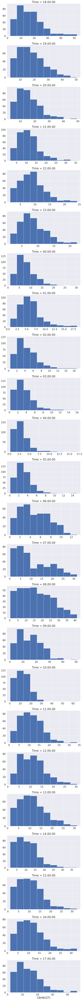

In [ ]:
  sns.set(font_scale=2)
  plt.figure(figsize=(15, 5))
  g = sns.FacetGrid(
      new_df,
      row='Time',
      sharex=False,
      sharey=False,
      height=5,
      aspect=2,
  )
  g = g.map(plt.hist, 'C6H6(GT)').add_legend()
  plt.show()

Видим, что данные имеют разное распределение в зависимости от времени.

In [ ]:
time_mapping = dict(zip(['00.00.00', '01.00.00', '02.00.00', 
                         '03.00.00', '04.00.00', '05.00.00',
                         '06.00.00', '07.00.00', '08.00.00',
                         '09.00.00', '10.00.00', '11.00.00', 
                         '12.00.00', '13.00.00', '14.00.00',
                         '15.00.00', '16.00.00', '17.00.00',
                         '18.00.00','19.00.00', '20.00.00',
                         '21.00.00','22.00.00', '23.00.00'], range(0, 24)))
changed_df = new_df.copy()
changed_df.loc[:, 'Time'] = changed_df.Time.map(time_mapping)

In [ ]:
changed_df

,Date,Time,CO(GT),PT08.S1(CO),C6H6(GT),PT08.S2(NMHC),NOx(GT),PT08.S3(NOx),NO2(GT),PT08.S4(NO2),PT08.S5(O3),T,RH,AH
0,10/03/2004,18,2.6,1360.0,11.9,1046.0,166.0,1056.0,113.0,1692.0,1268.0,13.6,48.9,0.7578
1,10/03/2004,19,2.0,1292.0,9.4,955.0,103.0,1174.0,92.0,1559.0,972.0,13.3,47.7,0.7255
2,10/03/2004,20,2.2,1402.0,9.0,939.0,131.0,1140.0,114.0,1555.0,1074.0,11.9,54.0,0.7502
3,10/03/2004,21,2.2,1376.0,9.2,948.0,172.0,1092.0,122.0,1584.0,1203.0,11.0,60.0,0.7867
4,10/03/2004,22,1.6,1272.0,6.5,836.0,131.0,1205.0,116.0,1490.0,1110.0,11.2,59.6,0.7888
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9352,04/04/2005,10,3.1,1314.0,13.5,1101.0,472.0,539.0,190.0,1374.0,1729.0,21.9,29.3,0.7568
9353,04/04/2005,11,2.4,1163.0,11.4,1027.0,353.0,604.0,179.0,1264.0,1269.0,24.3,23.7,0.7119
9354,04/04/2005,12,2.4,1142.0,12.4,1063.0,293.0,603.0,175.0,1241.0,1092.0,26.9,18.3,0.6406
9355,04/04/2005,13,2.1,1003.0,9.5,961.0,235.0,702.0,156.0,1041.0,770.0,28.3,13.5,0.5139


No handles with labels found to put in legend.


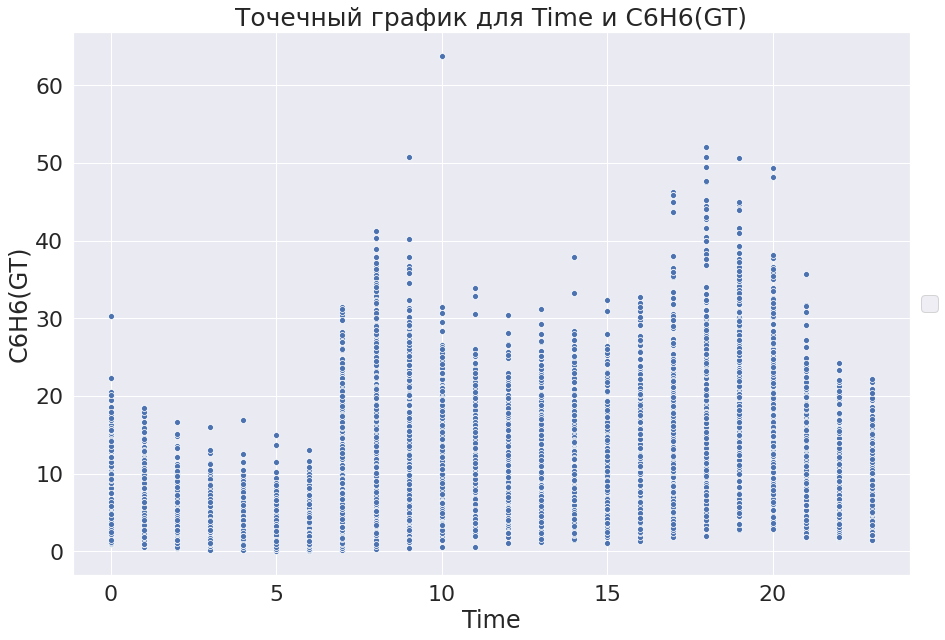

In [ ]:
plot_scatter('Time','C6H6(GT)',changed_df,legend='brief')

Видим, что в ночное время, большинство значений целевой переменной ниже, чем в дневное.

###CO(GT) - True hourly averaged concentration CO in mg/m^3

Построим гистограмму данного признака

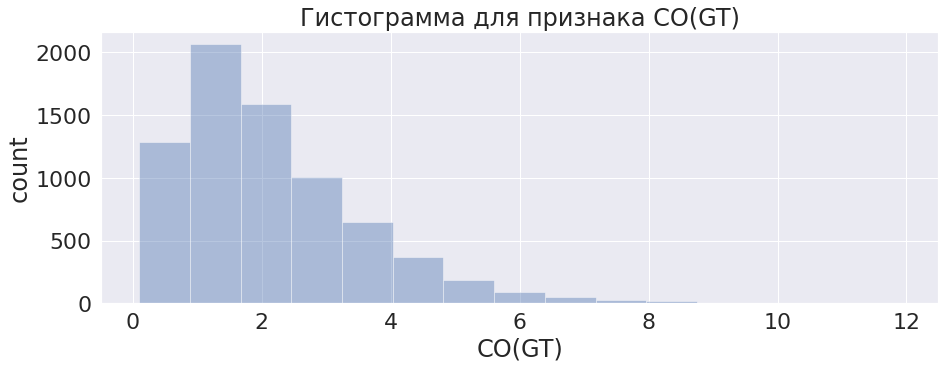

In [ ]:
plot_hist('CO(GT)',new_df)

Пока гистограмма совершенно не напоминает нормальное распределение. Попробуем проверить логнормальность.

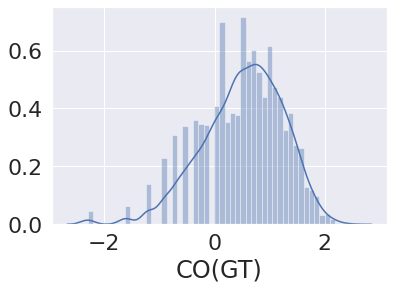

In [ ]:
sns.distplot(np.log(new_df['CO(GT)']))

In [ ]:
check_normality(np.log(new_df.dropna(subset=['CO(GT)'])['CO(GT)']),'log(CO(GT))')

Statistics=371.633, p=0.000
Гипотеза о нормальности выборки по признаку 'log(CO(GT))'должна быть отклонена


Как видим, признак 'CO(GT)' не имеет даже логнормального распределения. Но логарифм больше похож на нормальное распределение поэтому возможно лучше будет оставить его.
Посмотрим на точечный график данного признака с целевой переменной.

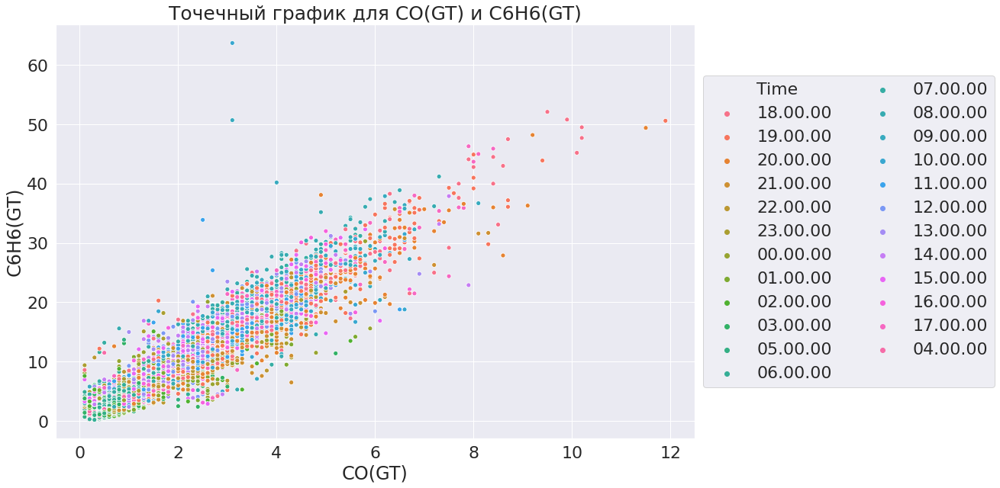

In [ ]:
plot_scatter('CO(GT)','C6H6(GT)',data=new_df.dropna(subset=['CO(GT)']),hue='Time',legend='brief')

Как видим, у данного признака имеется ярко выраженная зависимость с целевой переменной. Также замечаем что в ночной промежуток времени переменная имеет более низкие значения, чем в остальное время.

<Figure size 1080x360 with 0 Axes>

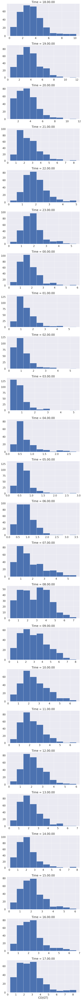

In [ ]:
  sns.set(font_scale=2)
  plt.figure(figsize=(15, 5))
  g = sns.FacetGrid(
      new_df,
      row='Time',
      sharex=False,
      sharey=False,
      height=5,
      aspect=2,
  )
  g = g.map(plt.hist, 'CO(GT)').add_legend()
  plt.show()

Из данных гистограмм видно, что данные имеют разное распределение в зависимости от времени.

###PT08.S1(CO) (tin oxide) hourly averaged sensor response.

Построим гистограмму данного признака

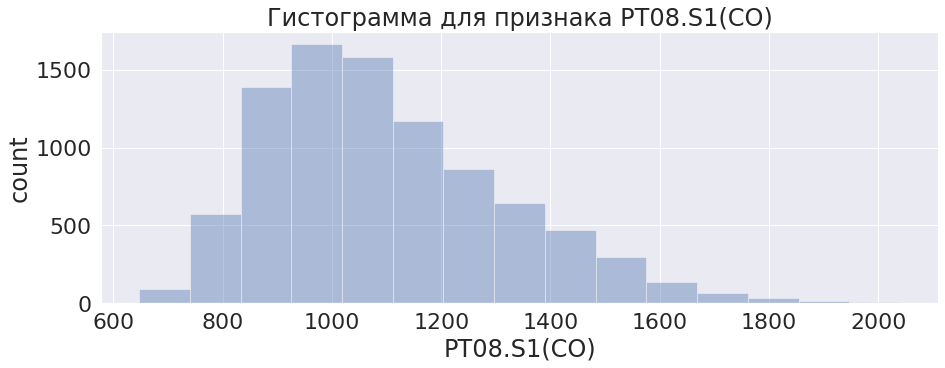

In [ ]:
plot_hist('PT08.S1(CO)',new_df)

In [ ]:
check_normality(data=new_df['PT08.S1(CO)'],feat='PT08.S1(CO)')

Statistics=717.498, p=0.000
Гипотеза о нормальности выборки по признаку 'PT08.S1(CO)'должна быть отклонена


Пока гистограмма совершенно не напоминает нормальное распределение. Попробуем проверить логнормальность.

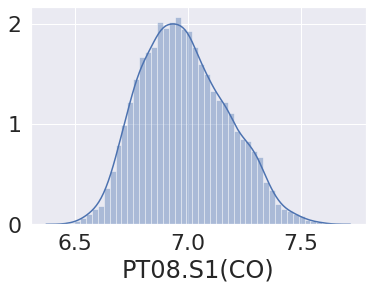

In [ ]:
sns.distplot(np.log(new_df['PT08.S1(CO)']))

In [ ]:
check_normality(np.log(new_df.dropna(subset=['PT08.S1(CO)'])['PT08.S1(CO)']),'log(PT08.S1(CO))')

Statistics=206.736, p=0.000
Гипотеза о нормальности выборки по признаку 'log(PT08.S1(CO))'должна быть отклонена


Как видим, признак 'CO(GT)' не имеет даже логнормального распределения.
Посмотрим на точечный график данного признака с целевой переменной.

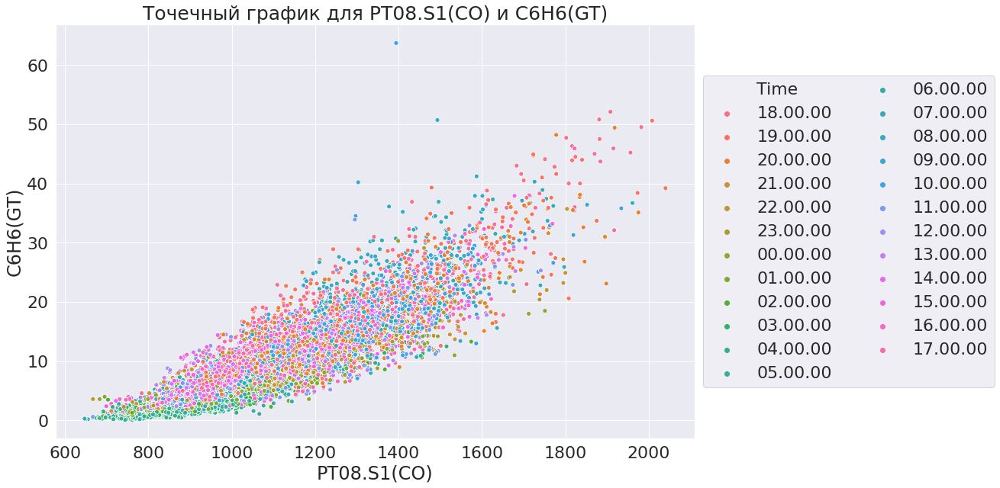

In [ ]:
plot_scatter('PT08.S1(CO)','C6H6(GT)',data=new_df,hue='Time',legend='brief')

Как видим, у данного признака имеется нелинейная зависимость с целевой переменной. Также замечаем что в промежуток с 00:00 по 5:00 переменная имеет более низкие значения, чем в остальное время.

<Figure size 1080x360 with 0 Axes>

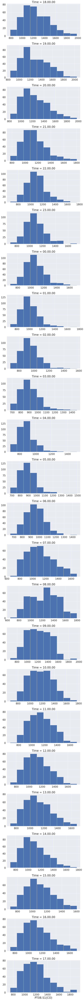

In [ ]:
  sns.set(font_scale=2)
  plt.figure(figsize=(15, 5))
  g = sns.FacetGrid(
      new_df,
      row='Time',
      sharex=False,
      sharey=False,
      height=5,
      aspect=2,
  )
  g = g.map(plt.hist, 'PT08.S1(CO)').add_legend()
  plt.show()

Из данных гистограмм видно, что данные имеют разное распределение в зависимости от времен, но в целом достаточно похожи.

###PT08.S2(NMHC) - PT08.S2 (titania) hourly averaged sensor response (nominally NMHC targeted)

In [ ]:
feature = 'PT08.S2(NMHC)'

Построим гистограмму данного признака

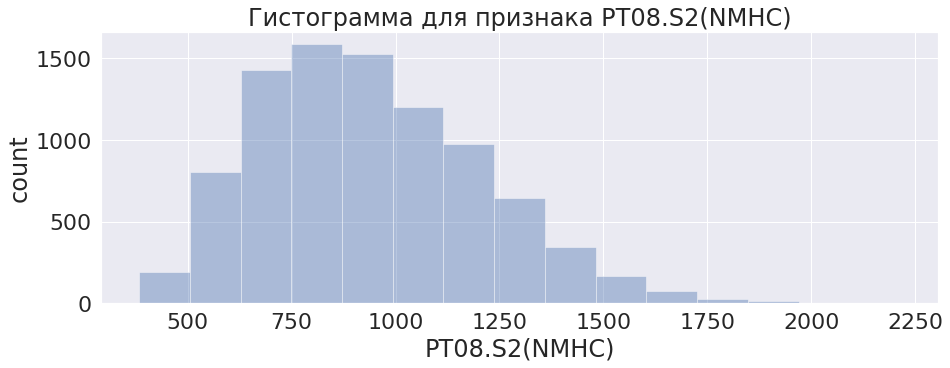

In [ ]:
plot_hist(feature,new_df)

In [ ]:
check_normality(data=new_df[feature],feat=feature)

Statistics=414.713, p=0.000
Гипотеза о нормальности выборки по признаку 'PT08.S2(NMHC)'должна быть отклонена


Пока гистограмма совершенно не напоминает нормальное распределение. Попробуем проверить логнормальность.

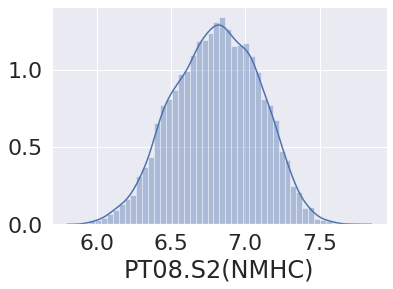

In [ ]:
sns.distplot(np.log(new_df[feature]))

In [ ]:
check_normality(np.log(new_df.dropna(subset=[feature])[feature]),'log({})'.format(feature))

Statistics=132.561, p=0.000
Гипотеза о нормальности выборки по признаку 'log(PT08.S2(NMHC))'должна быть отклонена


Как видим, данный не имеет даже логнормального распределения. Но логарифм больше похож на нормальное распределение поэтому возможно лучше будет оставить его.
Посмотрим на точечный график данного признака с целевой переменной.

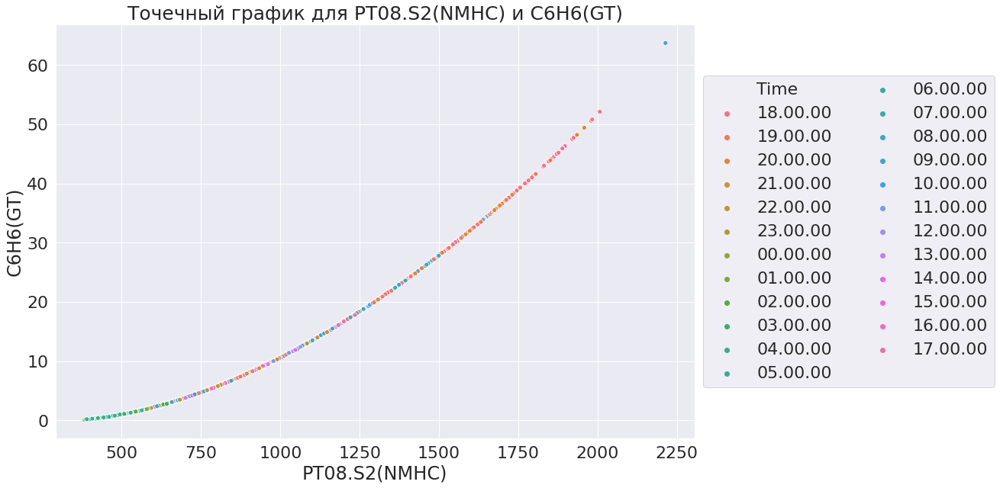

In [ ]:
plot_scatter(feature,'C6H6(GT)',data=new_df,hue='Time',legend='brief')

Опа, вот это поворот, конечно, видим, что у данного признака имеется отчетливая нелинейная зависимость с целевой переменной. Ее вид похож на квадратичную. Убедимся в этом.

In [ ]:
changed_df = new_df.copy()
changed_df['PT08.S2(NMHC)'] = np.power(changed_df['PT08.S2(NMHC)'],2)

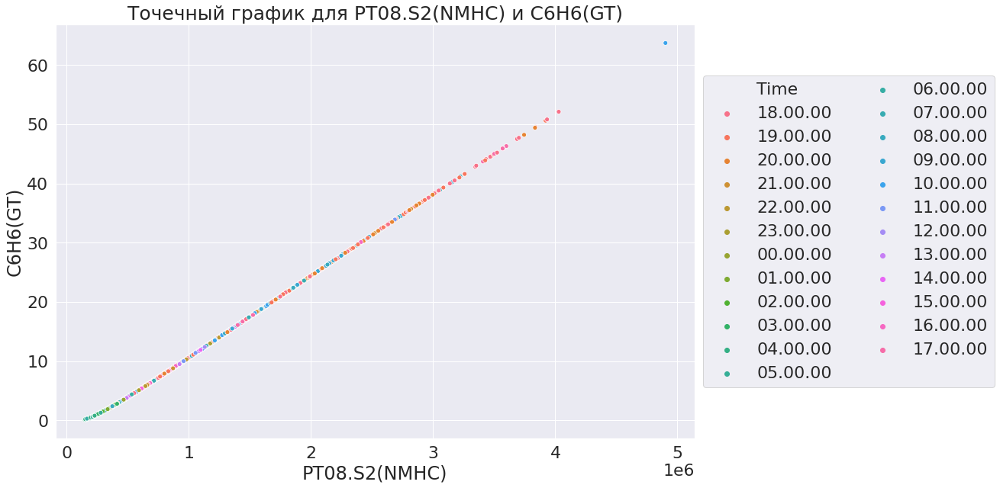

In [ ]:
plot_scatter(feature,'C6H6(GT)',data=changed_df,hue='Time',legend='brief')

Что  следовало ожидать, возведя расмматриваемую переменную в квадрат, мы получили линейную зависимость. Также замечаем что в промежуток с 00:00 по 5:00 переменная имеет более низкие значения, чем в остальное время.

<Figure size 1080x360 with 0 Axes>

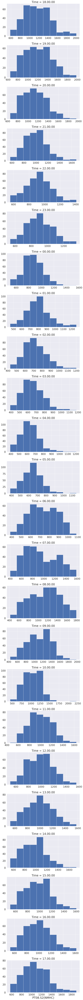

In [ ]:
  sns.set(font_scale=2)
  plt.figure(figsize=(15, 5))
  g = sns.FacetGrid(
      new_df,
      row='Time',
      sharex=False,
      sharey=False,
      height=5,
      aspect=2,
  )
  g = g.map(plt.hist, feature).add_legend()
  plt.show()

Из данных гистограмм видно, что данные имеют разное распределение в зависимости от времени, но в целом достаточно похожи.

###NOx(GT) - True hourly averaged NOx concentration in ppb

In [ ]:
feature = 'NOx(GT)'

Построим гистограмму данного признака

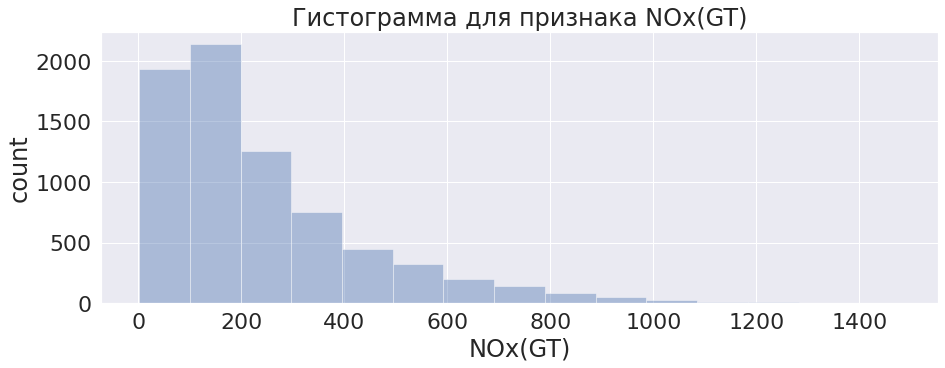

In [ ]:
plot_hist(feature,new_df)

In [ ]:
check_normality(data=new_df[feature],feat=feature)

Statistics=nan, p=nan
Гипотеза о нормальности выборки по признаку 'NOx(GT)'должна быть отклонена


Пока гистограмма совершенно не напоминает нормальное распределение. Попробуем проверить логнормальность.

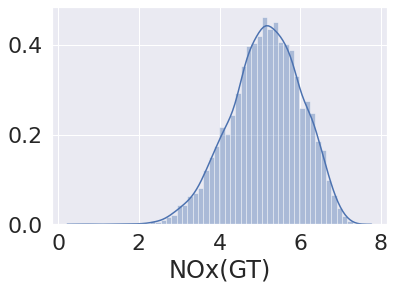

In [ ]:
sns.distplot(np.log(new_df[feature]))

In [ ]:
check_normality(np.log(new_df.dropna(subset=[feature])[feature]),'log({})'.format(feature))

Statistics=120.274, p=0.000
Гипотеза о нормальности выборки по признаку 'log(NOx(GT))'должна быть отклонена


Как видим, данный не имеет даже логнормального распределения.  Но логарифм больше похож на нормальное распределение поэтому возможно лучше будет оставить его.
Посмотрим на точечный график данного признака с целевой переменной.

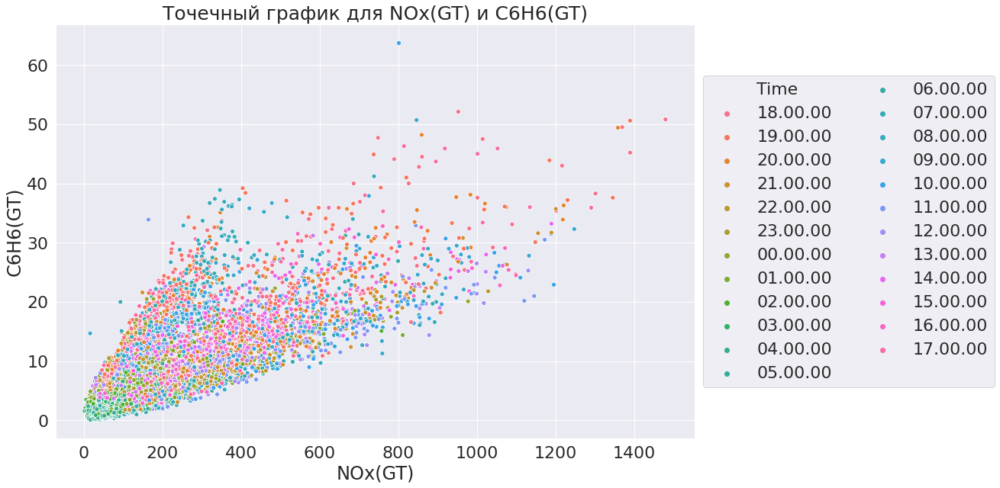

In [ ]:
plot_scatter(feature,'C6H6(GT)',data=new_df,hue='Time',legend='brief')

По графику видно, что при увеличении значения признака, значение таргета имеет разную дисперсию, а это может привести к гетероскедастичности остатков(

Также снова заметим замечаем что в промежуток с 00:00 по 5:00 переменная имеет более низкие значения, чем в остальное время.

<Figure size 1080x360 with 0 Axes>

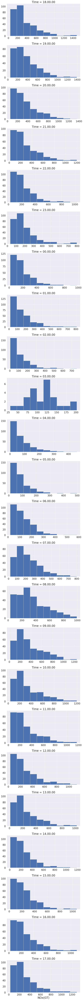

In [ ]:
  sns.set(font_scale=2)
  plt.figure(figsize=(15, 5))
  g = sns.FacetGrid(
      new_df,
      row='Time',
      sharex=False,
      sharey=False,
      height=5,
      aspect=2,
  )
  g = g.map(plt.hist, feature).add_legend()
  plt.show()

Из данных гистограмм видно, что данные имеют разное распределение в зависимости от времени, но в целом достаточно похожи, за исключением распределений для 3-го часа ночи

###PT08.S3(NOx) (tungsten oxide) hourly averaged sensor response (nominally NOx targeted)

In [ ]:
feature = 'PT08.S3(NOx)'

Построим гистограмму данного признака

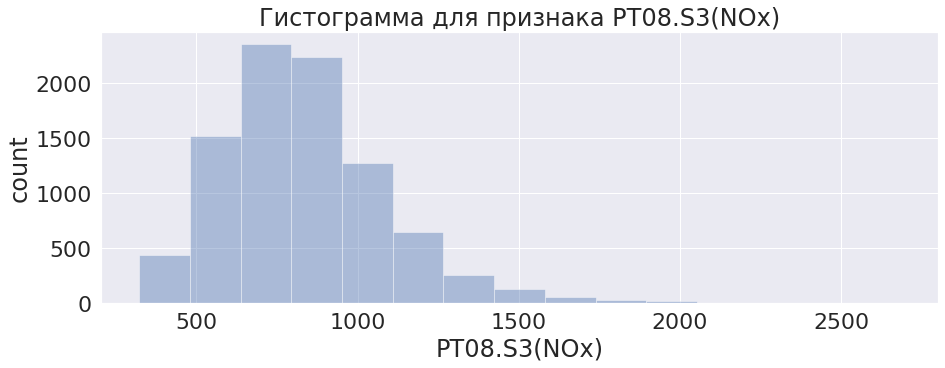

In [ ]:
plot_hist(feature,new_df)

In [ ]:
check_normality(data=new_df[feature],feat=feature)

Statistics=1799.602, p=0.000
Гипотеза о нормальности выборки по признаку 'PT08.S3(NOx)'должна быть отклонена


Пока гистограмма совершенно не напоминает нормальное распределение. Попробуем проверить логнормальность.

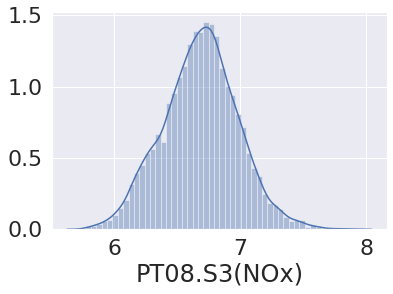

In [ ]:
sns.distplot(np.log(new_df[feature]))

In [ ]:
check_normality(np.log(new_df.dropna(subset=[feature])[feature]),'log({})'.format(feature))

Statistics=4.642, p=0.098
Нельзя отвергнуть гипотезу о нормальности выборки по признаку 'log(PT08.S3(NOx))'


Как видим, данный не имеет даже логнормального распределения.  Но логарифм больше похож на нормальное распределение поэтому возможно лучше будет оставить его.
Посмотрим на точечный график данного признака с целевой переменной.

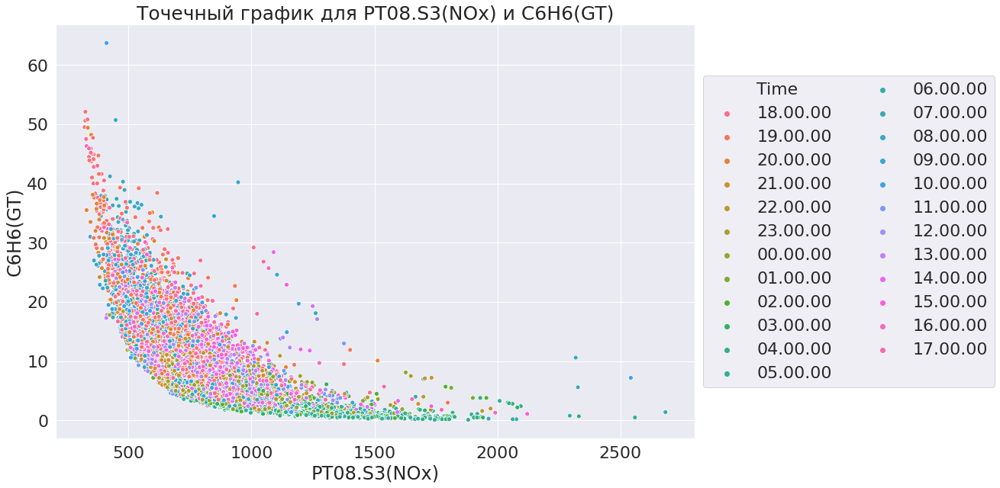

In [ ]:
plot_scatter(feature,'C6H6(GT)',data=new_df,hue='Time',legend='brief')

По графику видно, что данныей признак имеет обратную нелинейную зависимость, возожно, что это обратная квадратичная функция, посмотрим, так ли это

In [ ]:
changed_df = new_df.copy()
changed_df[feature] = np.power(changed_df[feature],-2)

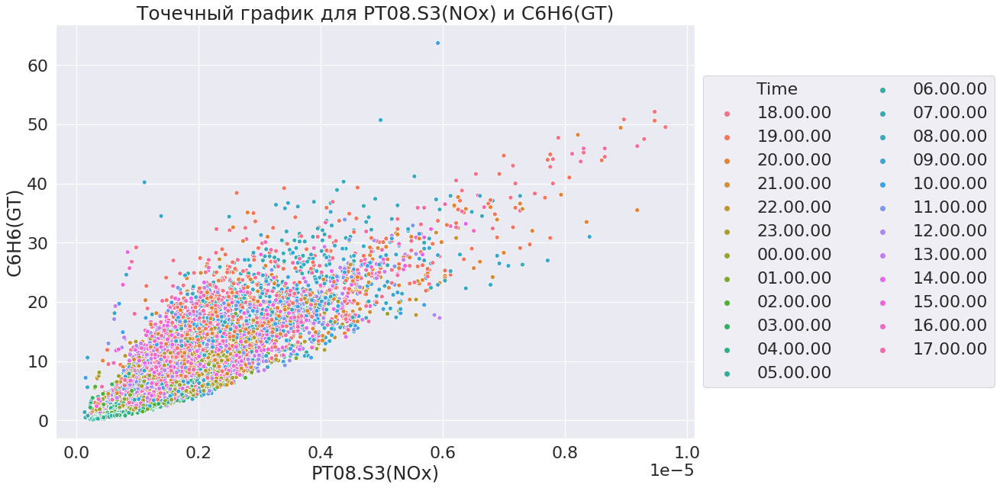

In [ ]:
plot_scatter(feature,'C6H6(GT)',data=changed_df,hue='Time',legend='brief')

Что  следовало ожидать, возведя расмматриваемую переменную в квадрат, мы получили линейную зависимость. Но снова видим, что при увеличении значения признака, значение таргета имеет разную дисперсию, а это может привести к гетероскедастичности остатков(

Также снова заметим замечаем что в промежуток с 00:00 по 5:00 переменная имеет более низкие значения, чем в остальное время.

<Figure size 1080x360 with 0 Axes>

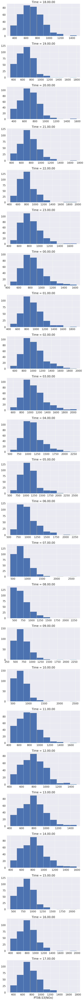

In [ ]:
  sns.set(font_scale=2)
  plt.figure(figsize=(15, 5))
  g = sns.FacetGrid(
      new_df,
      row='Time',
      sharex=False,
      sharey=False,
      height=5,
      aspect=2,
  )
  g = g.map(plt.hist, feature).add_legend()
  plt.show()

Из данных гистограмм видно, что данные имеют разное распределение в зависимости от времени, но в целом достаточно похожи.

###NO2(GT) - true hourly averaged NO2 concentration in microg/m^3 (reference analyzer)

In [ ]:
feature = 'NO2(GT)'

Построим гистограмму данного признака

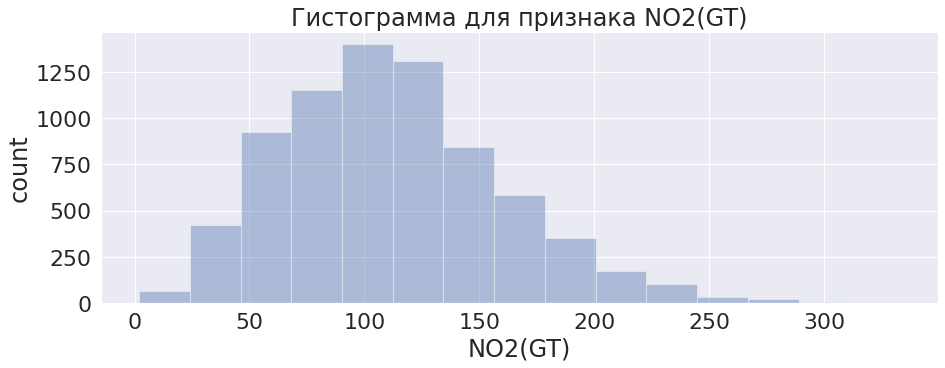

In [ ]:
plot_hist(feature,new_df)

In [ ]:
check_normality(data=new_df[feature],feat=feature)

Statistics=nan, p=nan
Гипотеза о нормальности выборки по признаку 'NO2(GT)'должна быть отклонена


Гистограмма по виду, напоминает нормальное распределение, но тест показывает обратное( Попробуем проверить логнормальность.

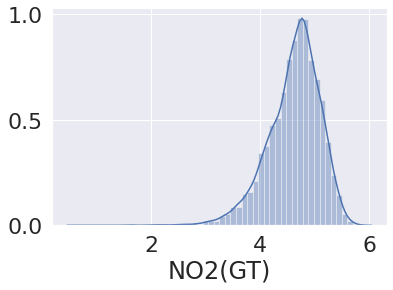

In [ ]:
sns.distplot(np.log(new_df[feature]))

In [ ]:
check_normality(np.log(new_df.dropna(subset=[feature])[feature]),'log({})'.format(feature))

Statistics=1224.701, p=0.000
Гипотеза о нормальности выборки по признаку 'log(NO2(GT))'должна быть отклонена


Как видим, данный не имеет даже логнормального распределения.
Посмотрим на точечный график данного признака с целевой переменной.

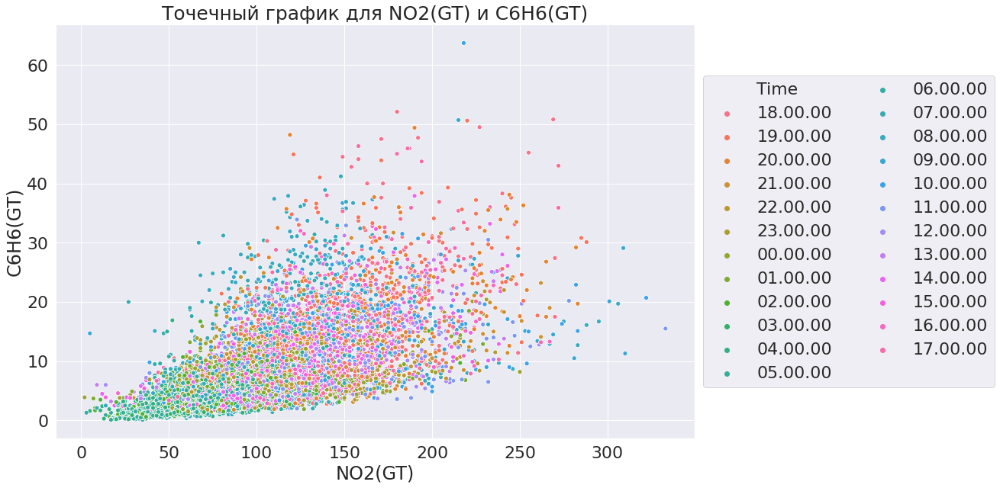

In [ ]:
plot_scatter(feature,'C6H6(GT)',data=new_df,hue='Time',legend='brief')

По графику видно, что в данных имеется какой-то тренд, но нельзя сказать о какой-то хорошей зависимости.

Вдобавок, снова видим, что при увеличении значения признака, значение таргета имеет разную дисперсию, а это может привести к гетероскедастичности остатков(

Также снова заметим замечаем что в промежуток с 00:00 по 5:00 переменная имеет более низкие значения, чем в остальное время.

<Figure size 1080x360 with 0 Axes>

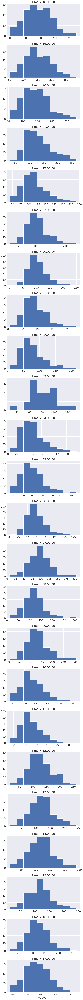

In [ ]:
  sns.set(font_scale=2)
  plt.figure(figsize=(15, 5))
  g = sns.FacetGrid(
      new_df,
      row='Time',
      sharex=False,
      sharey=False,
      height=5,
      aspect=2,
  )
  g = g.map(plt.hist, feature).add_legend()
  plt.show()

Из данных гистограмм видно, что данные имеют разное распределение в зависимости от времени, но в целом достаточно похожи, за исключением данных, для третьего часа ночи.

###PT08.S4(NO2) (tungsten oxide) hourly averaged sensor response (nominally NO2 targeted)

In [ ]:
feature = 'PT08.S4(NO2)'

Построим гистограмму данного признака

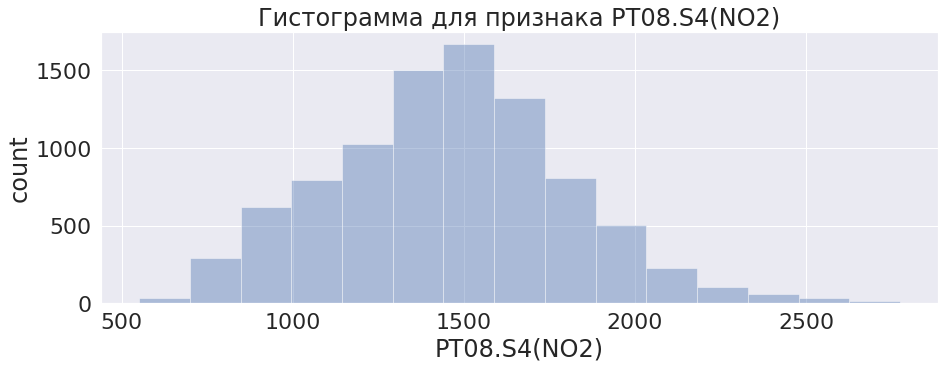

In [ ]:
plot_hist(feature,new_df)

In [ ]:
check_normality(data=new_df[feature],feat=feature)

Statistics=64.204, p=0.000
Гипотеза о нормальности выборки по признаку 'PT08.S4(NO2)'должна быть отклонена


Гистограмма по виду, напоминает нормальное распределение, но тест показывает обратное( Попробуем проверить логнормальность.

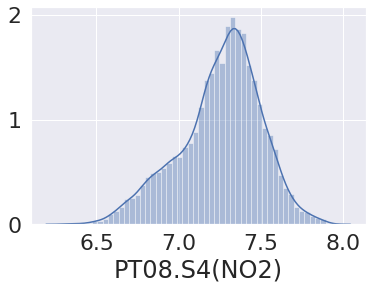

In [ ]:
sns.distplot(np.log(new_df[feature]))

In [ ]:
check_normality(np.log(new_df.dropna(subset=[feature])[feature]),'log({})'.format(feature))

Statistics=326.333, p=0.000
Гипотеза о нормальности выборки по признаку 'log(PT08.S4(NO2))'должна быть отклонена


Как видим, данный не имеет даже логнормального распределения.
Посмотрим на точечный график данного признака с целевой переменной.

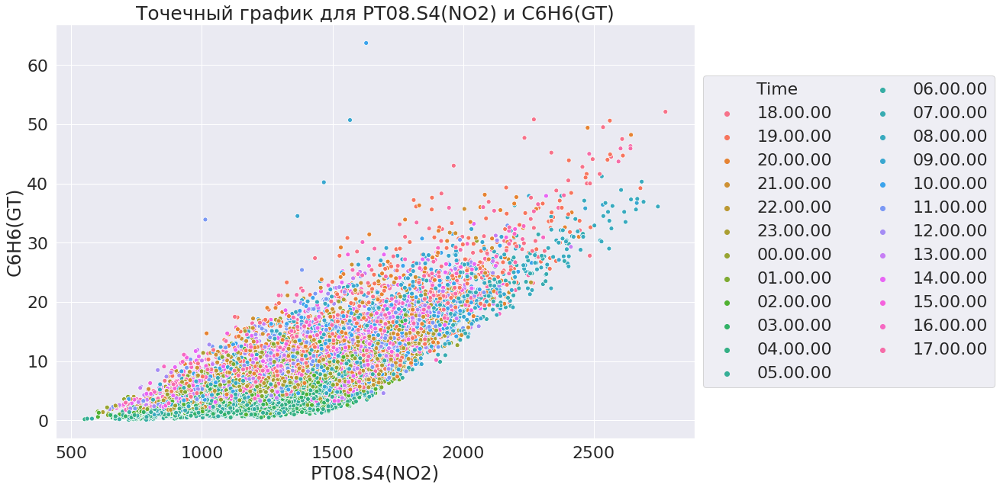

In [ ]:
plot_scatter(feature,'C6H6(GT)',data=new_df,hue='Time',legend='brief')

По графику видно, что в данных имеется какой-то тренд, и, возможно, есть линейная завсисимость.

Вдобавок, снова видим, что при увеличении значения признака, значение таргета имеет разную дисперсию, а это может привести к гетероскедастичности остатков(

Также снова заметим замечаем что в промежуток с 00:00 по 5:00 переменная имеет более низкие значения, чем в остальное время.

<Figure size 1080x360 with 0 Axes>

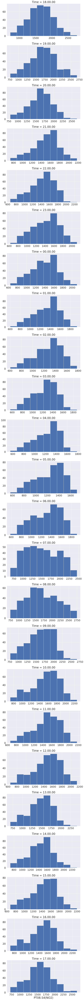

In [ ]:
  sns.set(font_scale=2)
  plt.figure(figsize=(15, 5))
  g = sns.FacetGrid(
      new_df,
      row='Time',
      sharex=False,
      sharey=False,
      height=5,
      aspect=2,
  )
  g = g.map(plt.hist, feature).add_legend()
  plt.show()

Из данных гистограмм видно, что данные имеют разное распределение в зависимости от времени, но в целом достаточно похожи, за исключением данных, для третьего часа ночи.

###PT08.S5(O3) (indium oxide) hourly averaged sensor response (nominally O3 targeted)

In [ ]:
feature = 'PT08.S5(O3)'

Построим гистограмму данного признака

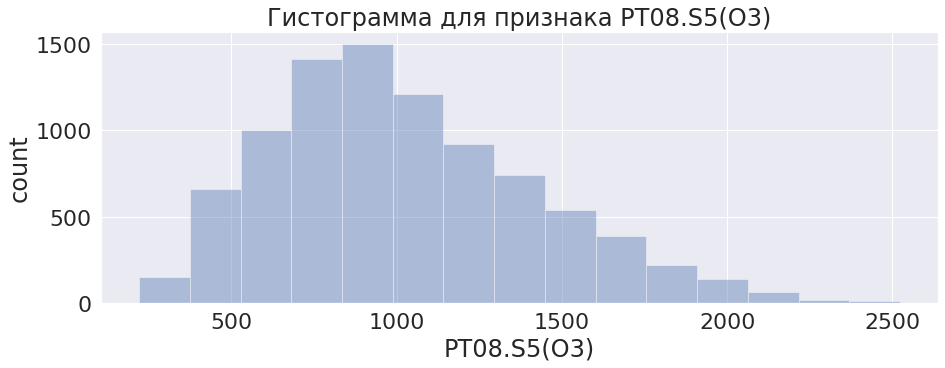

In [ ]:
plot_hist(feature,new_df)

In [ ]:
check_normality(data=new_df[feature],feat=feature)

Statistics=504.218, p=0.000
Гипотеза о нормальности выборки по признаку 'PT08.S5(O3)'должна быть отклонена


Гистограмма по виду, напоминает нормальное распределение c ассиметрией, но тест показывает обратное( Попробуем проверить логнормальность.

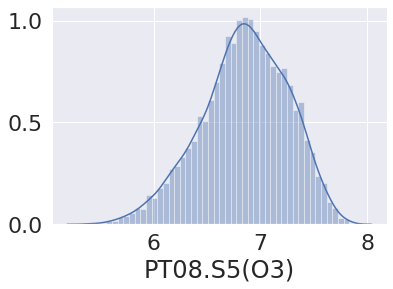

In [ ]:
sns.distplot(np.log(new_df[feature]))

In [ ]:
check_normality(np.log(new_df.dropna(subset=[feature])[feature]),'log({})'.format(feature))

Statistics=171.746, p=0.000
Гипотеза о нормальности выборки по признаку 'log(PT08.S5(O3))'должна быть отклонена


Как видим, данный не имеет даже логнормального распределения.  Но логарифм больше похож на нормальное распределение поэтому возможно лучше будет оставить его.
Посмотрим на точечный график данного признака с целевой переменной.

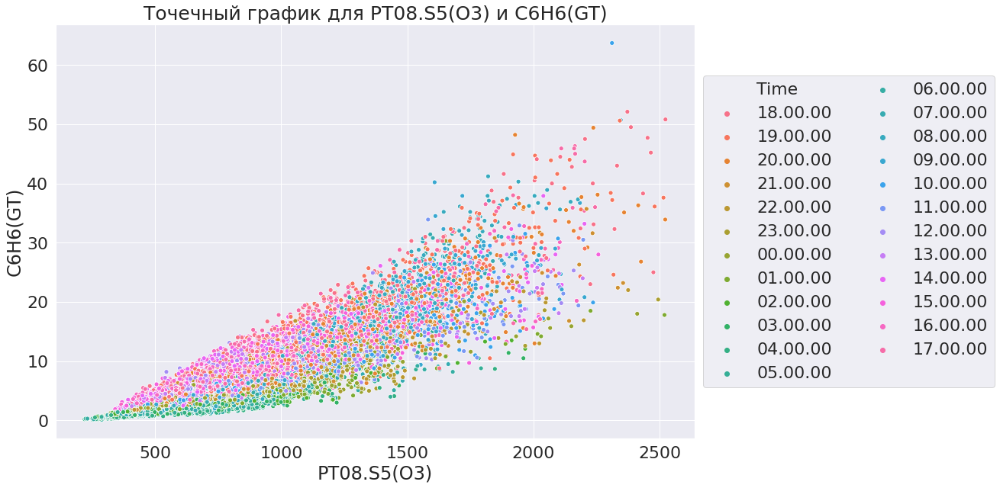

In [ ]:
plot_scatter(feature,'C6H6(GT)',data=new_df,hue='Time',legend='brief')

По графику видно, что в данных есть линейная завсисимость. Вдобавок, снова видим, что при увеличении значения признака, значение таргета имеет разную дисперсию, а это может привести к гетероскедастичности остатков(

Также снова заметим замечаем что в промежуток с 00:00 по 5:00 переменная имеет более низкие значения, чем в остальное время.

<Figure size 1080x360 with 0 Axes>

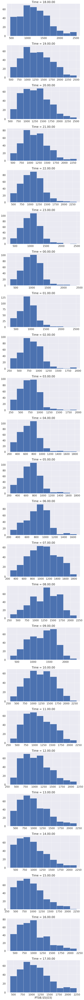

In [ ]:
  sns.set(font_scale=2)
  plt.figure(figsize=(15, 5))
  g = sns.FacetGrid(
      new_df,
      row='Time',
      sharex=False,
      sharey=False,
      height=5,
      aspect=2,
  )
  g = g.map(plt.hist, feature).add_legend()
  plt.show()

Из данных гистограмм видно, что данные имеют разное распределение в зависимости от времени, но в целом достаточно похожи, за исключением данных.

###Temperature in °C

In [ ]:
new_df.rename(columns={new_df.columns[11]: "Temperature" },inplace=True)

In [ ]:
feature = 'Temperature'

Построим гистограмму данного признака

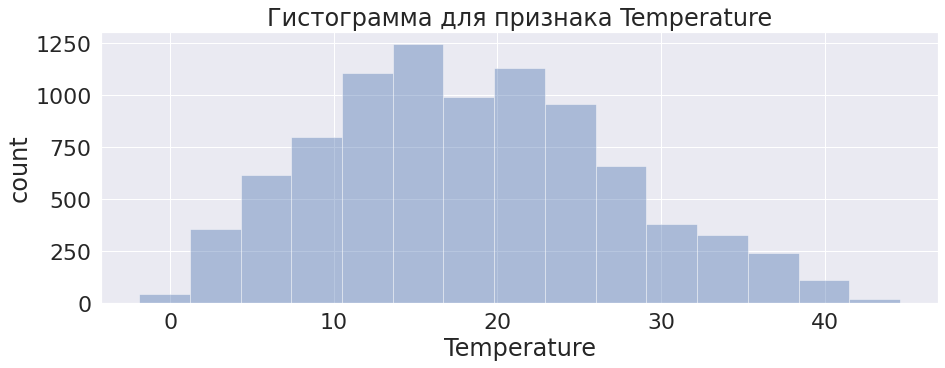

In [ ]:
plot_hist(feature,new_df)

In [ ]:
check_normality(data=new_df[feature],feat=feature)

Statistics=271.295, p=0.000
Гипотеза о нормальности выборки по признаку 'Temperature'должна быть отклонена


Гистограмма по виду, напоминает нормальное распределение, но тест показывает обратное(

Посмотрим на точечный график данного признака с целевой переменной.

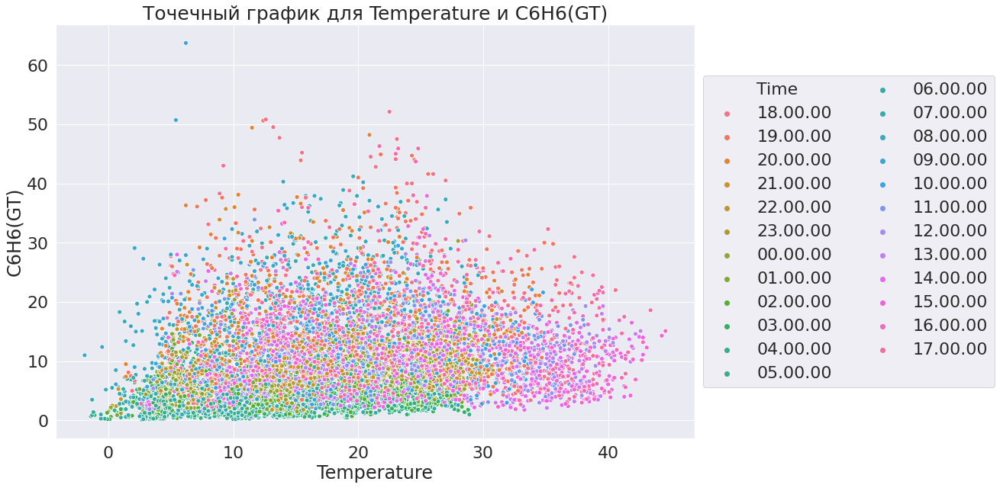

In [ ]:
plot_scatter(feature,'C6H6(GT)',data=new_df,hue='Time',legend='brief')

По графику не видно, что в данных есть какая-либо зависимость. Но в целом все, как и полагается, более низкая температура ночью, более высокая в дневные часы.

<Figure size 1080x360 with 0 Axes>

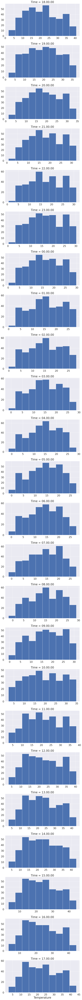

In [ ]:
  sns.set(font_scale=2)
  plt.figure(figsize=(15, 5))
  g = sns.FacetGrid(
      new_df,
      row='Time',
      sharex=False,
      sharey=False,
      height=5,
      aspect=2,
  )
  g = g.map(plt.hist, feature).add_legend()
  plt.show()

Из данных гистограмм видно, что данные имеют разное распределение в зависимости от времени, но в целом достаточно похожи.

###RH - Relative Humidity (%)

In [ ]:
feature = 'RH'

Построим гистограмму данного признака

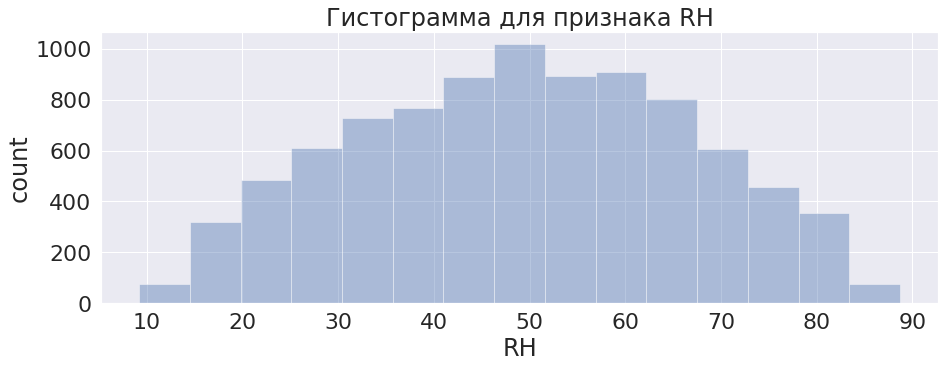

In [ ]:
plot_hist(feature,new_df)

In [ ]:
check_normality(data=new_df[feature],feat=feature)

Statistics=833.001, p=0.000
Гипотеза о нормальности выборки по признаку 'RH'должна быть отклонена


Гистограмма по виду, не напоминает нормальное распределение, что подтверждает тест(

Посмотрим на точечный график данного признака с целевой переменной.

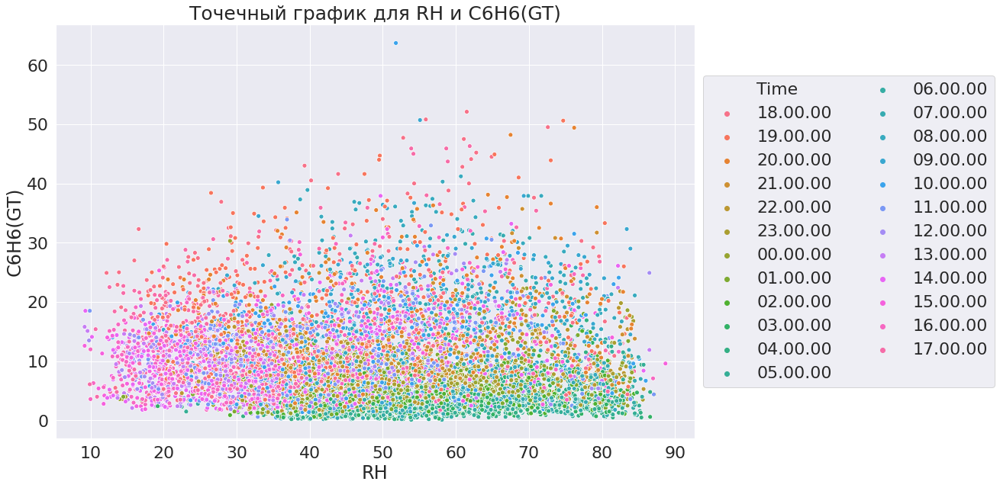

In [ ]:
plot_scatter(feature,'C6H6(GT)',data=new_df,hue='Time',legend='brief')

По графику не видно, что в данных есть какая-либо зависимость. Но в целом все, как и полагается, нобья значения относительной влажности быльше, чем днем.

<Figure size 1080x360 with 0 Axes>

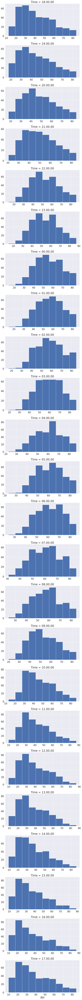

In [ ]:
  sns.set(font_scale=2)
  plt.figure(figsize=(15, 5))
  g = sns.FacetGrid(
      new_df,
      row='Time',
      sharex=False,
      sharey=False,
      height=5,
      aspect=2,
  )
  g = g.map(plt.hist, feature).add_legend()
  plt.show()

Из данных гистограмм видно, что данные имеют разное распределение в зависимости от времени.

###AH - Absolute Humidity

In [ ]:
feature = 'AH'

Построим гистограмму данного признака

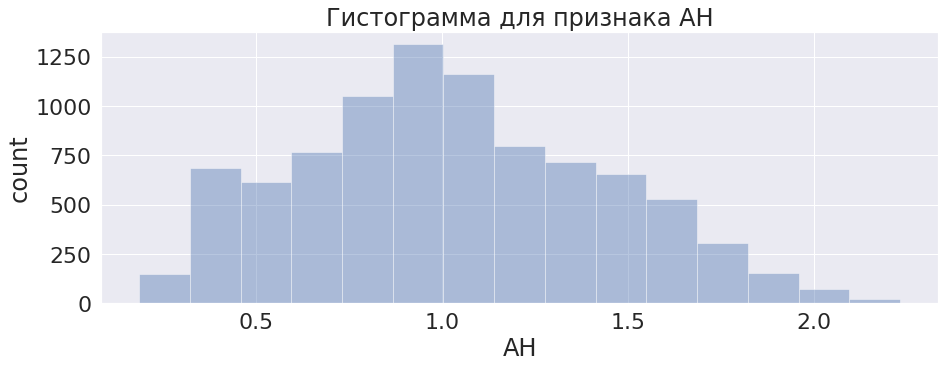

In [ ]:
plot_hist(feature,new_df)

In [ ]:
check_normality(data=new_df[feature],feat=feature)

Statistics=328.923, p=0.000
Гипотеза о нормальности выборки по признаку 'AH'должна быть отклонена


Гистограмма по виду, не напоминает нормальное распределение, что подтверждает тест(

Посмотрим на точечный график данного признака с целевой переменной.

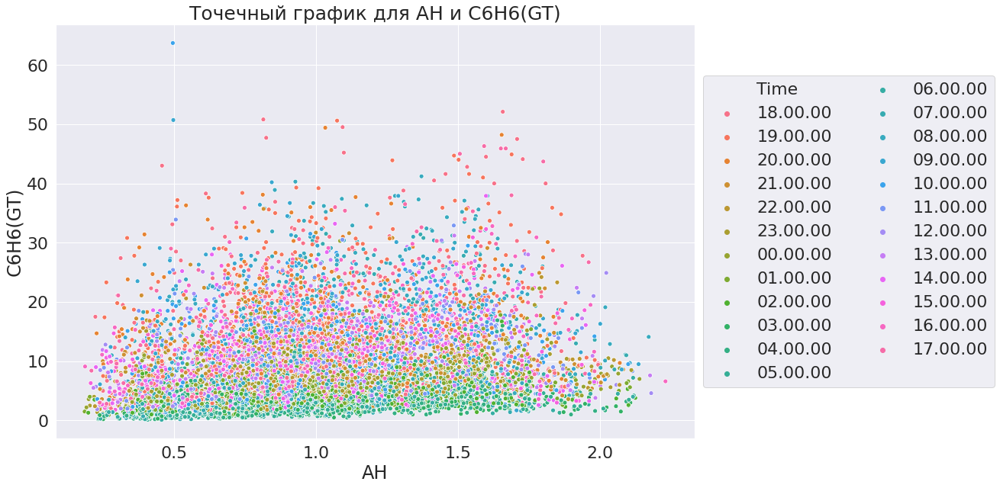

In [ ]:
plot_scatter(feature,'C6H6(GT)',data=new_df,hue='Time',legend='brief')

По графику не видно, что в данных есть какая-либо зависимость. Также наблюдается зависимость значений целевой переменной от времени.

<Figure size 1080x360 with 0 Axes>

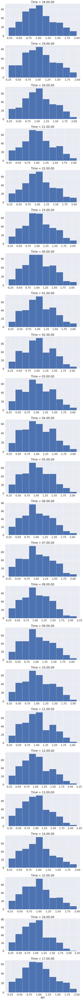

In [ ]:
  sns.set(font_scale=2)
  plt.figure(figsize=(15, 5))
  g = sns.FacetGrid(
      new_df,
      row='Time',
      sharex=False,
      sharey=False,
      height=5,
      aspect=2,
  )
  g = g.map(plt.hist, feature).add_legend()
  plt.show()

Из данных гистограмм видно, что данные имеют разное распределение в зависимости от времени.

##Target Analysis

###C6H6(GT) - True hourly averaged Benzene concentration in microg/m^3

In [ ]:
new_df.rename(columns={new_df.columns[4]: "Target" },inplace=True)

Построим гистограмму

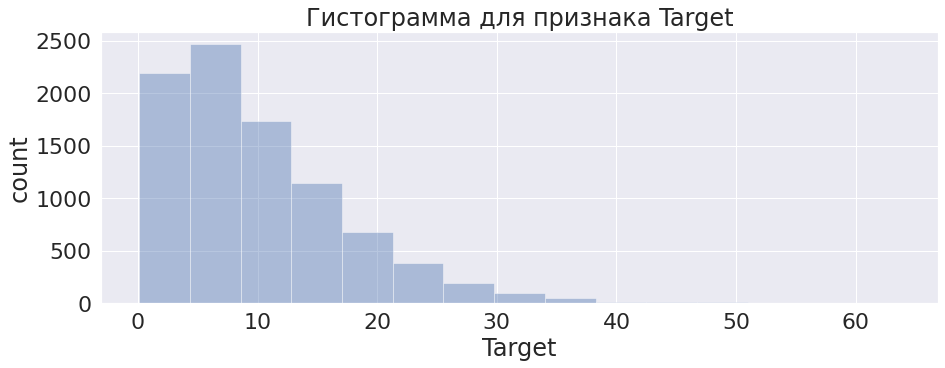

In [ ]:
plot_hist('Target',new_df)

In [ ]:
check_normality(data=new_df['Target'],feat='Target')

Statistics=2180.645, p=0.000
Гипотеза о нормальности выборки по признаку 'Target'должна быть отклонена


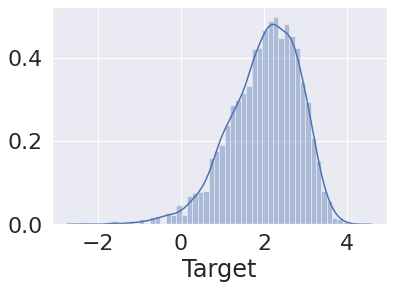

In [ ]:
sns.distplot(np.log(new_df['Target']))

In [ ]:
check_normality(np.log(new_df.dropna(subset=['Target'])['Target']),'log({})'.format('Target'))

Statistics=631.134, p=0.000
Гипотеза о нормальности выборки по признаку 'log(Target)'должна быть отклонена


Видим, что целевая переменная не распределена ни нормально ни логнормально.  Но логарифм больше похож на нормальное распределение поэтому возможно лучше будет оставить его.

##Multivariate analysis

##Pairplot

In [ ]:
sns.set(font_scale=1.5)
sns.pairplot(data=new_df)
plt.show()

Output hidden; open in https://colab.research.google.com to view.

Видно, что между многими признаками есть зависимость, но при этом признаки 'Temperature', 'RH', 'AH' почти ни с кем не коррелируют, убедимся в этом с помощью матриц корреляции.

##Correlation matrix##

Посмотрим на них с помощью heatmap

Начнем с коэффициентов Пирсона. Создадим heatmap который мы уже видели, когда использовали pandas_profiling

In [ ]:
corr_matrix_pearson_coef = new_df.corr()

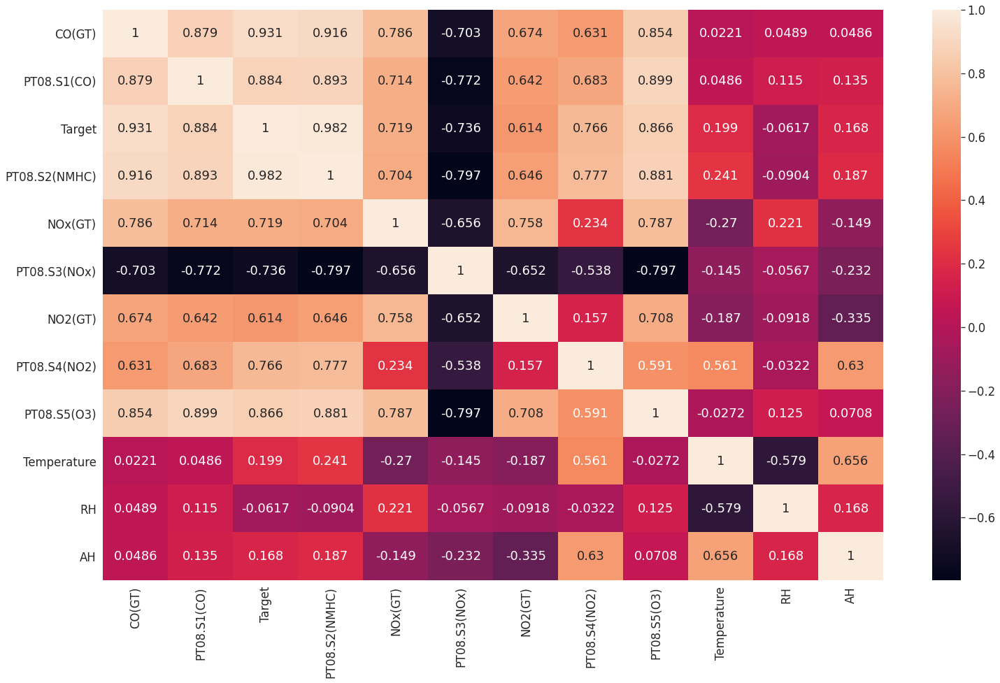

In [ ]:
plt.figure(figsize=(25, 15))
sns.heatmap(corr_matrix_pearson_coef, annot=True, fmt='.3g')
plt.show()

Видим, что имеется сильная линейная зависимость между 'CO(GT)', 'PT08.S1(CO)', 'PT08.S2(NMHC)', 'PT08.S5(O3)' и обратная линейная зависимость между переменной  'PT08.S3(NOx)' и вышеупомянутыми переменными.

In [ ]:
list_features1 = ['CO(GT)', 'PT08.S1(CO)', 'PT08.S2(NMHC)', 'PT08.S3(NOx)', 'PT08.S5(O3)', 'Target']
list_features2 = ['CO(GT)', 'PT08.S1(CO)', 'PT08.S2(NMHC)', 'PT08.S3(NOx)','PT08.S5(O3)', 'Target']
for feat1 in list_features1:
  for feat2 in list_features2:
    if feat1!=feat2:
      check_significance_pearson(new_df.dropna(),feat1,feat2)
  list_features2.remove(feat1)

Значение статистики = 0.8770137796782851, p-value=0.0
Коэффициент корреляции Пирсона между CO(GT) и PT08.S1(CO) статистически значим
Значение статистики = 0.9143102235139275, p-value=0.0
Коэффициент корреляции Пирсона между CO(GT) и PT08.S2(NMHC) статистически значим
Значение статистики = -0.7010378143018657, p-value=0.0
Коэффициент корреляции Пирсона между CO(GT) и PT08.S3(NOx) статистически значим
Значение статистики = 0.8534800440518565, p-value=0.0
Коэффициент корреляции Пирсона между CO(GT) и PT08.S5(O3) статистически значим
Значение статистики = 0.9300084387599901, p-value=0.0
Коэффициент корреляции Пирсона между CO(GT) и Target статистически значим
Значение статистики = 0.8860683080595463, p-value=0.0
Коэффициент корреляции Пирсона между PT08.S1(CO) и PT08.S2(NMHC) статистически значим
Значение статистики = -0.7628945121565972, p-value=0.0
Коэффициент корреляции Пирсона между PT08.S1(CO) и PT08.S3(NOx) статистически значим
Значение статистики = 0.897166355105183, p-value=0.0
Коэ

Получаем, что все коэффициенты между рассматриваемыми переменными и таргетом оказались значимы.

Теперь посмотрим на матрицу коэффициентов Спирмана

In [ ]:
corr_matrix_spearman_coef = new_df.corr(method='spearman')

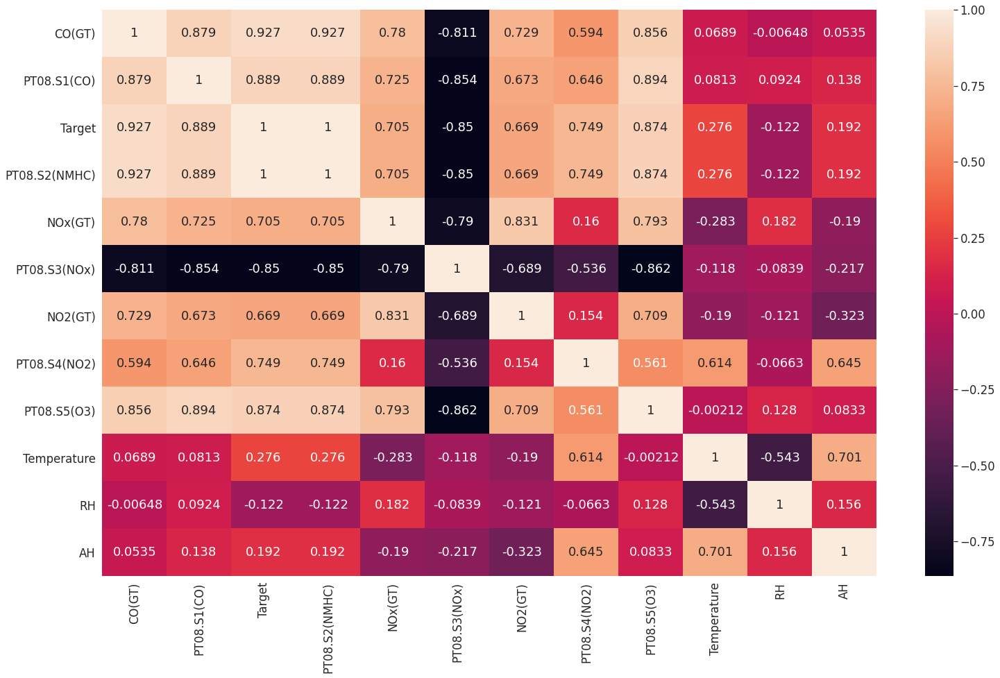

In [ ]:
plt.figure(figsize=(25, 15))
sns.heatmap(corr_matrix_spearman_coef, annot=True, fmt='.3g')
plt.show()

Выводы из представленной heatmap:


1.   Целевая переменная полностью нелинейно взаимосвязана с переменной 'PT08.S2(NMHC)'
2.   Между переменной  'PT08.S3(NOx)' и таргетом нелинейная связь значительно сильнее линейной.
3.   Между переменными 'PT08.S1(CO)', 'PT08.S5(O3)'' и таргетом нелинейная связь сильнее линейной, но незначительно.

Проверим значимость коэффициентов Спирмана между этими переменными.





In [ ]:
list_features1 = ['CO(GT)', 'PT08.S1(CO)', 'PT08.S2(NMHC)', 'PT08.S3(NOx)', 'PT08.S5(O3)', 'Target']
list_features2 = ['CO(GT)', 'PT08.S1(CO)', 'PT08.S2(NMHC)', 'PT08.S3(NOx)','PT08.S5(O3)', 'Target']
for feat1 in list_features1:
  for feat2 in list_features2:
    if feat1!=feat2:
      check_significance_spearman(new_df.dropna(),feat1,feat2)
  list_features2.remove(feat1)

Значение статистики = 0.8759933233823209, p-value=0.0
Коэффициент корреляции Спирмана между CO(GT) и PT08.S1(CO) статистически значим
Значение статистики = 0.9259295871785961, p-value=0.0
Коэффициент корреляции Спирмана между CO(GT) и PT08.S2(NMHC) статистически значим
Значение статистики = -0.805857071115575, p-value=0.0
Коэффициент корреляции Спирмана между CO(GT) и PT08.S3(NOx) статистически значим
Значение статистики = 0.8571132769078067, p-value=0.0
Коэффициент корреляции Спирмана между CO(GT) и PT08.S5(O3) статистически значим
Значение статистики = 0.9259336942454144, p-value=0.0
Коэффициент корреляции Спирмана между CO(GT) и Target статистически значим
Значение статистики = 0.8821378896956621, p-value=0.0
Коэффициент корреляции Спирмана между PT08.S1(CO) и PT08.S2(NMHC) статистически значим
Значение статистики = -0.8458440890897937, p-value=0.0
Коэффициент корреляции Спирмана между PT08.S1(CO) и PT08.S3(NOx) статистически значим
Значение статистики = 0.8972226307402346, p-value=

Получаем, что все коэффициенты между рассматриваемыми переменными и таргетом оказались значимы. Теперь посмотрим на коэффициенты корреляции Пирсона между таргетом и квадратом переменной 'PT08.S2(NMHC)', и обратным квадратом переменной 'PT08.S3(NOx)'.

In [ ]:
stat,pv = st.pearsonr(new_df.dropna()['Target'],np.power(new_df.dropna()['PT08.S2(NMHC)'],2))
print('Значение статистики = {}, p-value={}'.format(stat,pv))

Значение статистики = 0.9998149959911425, p-value=0.0


Коэффициент корреляции Пирсона между таргетом и квадратом переменной 'PT08.S2(NMHC)' очень близок к 1 и статистичеки значим, значит есть почти полная зависимость между таргетом и рассматриваемой переменной.

In [ ]:
stat,pv = st.pearsonr(new_df.dropna()['Target'],np.power(new_df.dropna()['PT08.S3(NOx)'],-2))
print('Значение статистики = {}, p-value={}'.format(stat,pv))

Значение статистики = 0.8355864223831937, p-value=0.0


Коэффициент корреляции Пирсона между таргетом и обратным квадратом переменной 'PT08.S3(NOx)' меньше чем коэффициент Спирмена между таргетом и рассматриваемой переменной, но больше, чем коэффициент Пирсона между ними. Также полученный коэффициент статистически значим.

#Outliers

Для поиска выбросов воспользуемся алгоритмом Isolation Forest, который рассматривает признаки не по отдельности, а в пространстве. Также этот алгоритм позволяет отдельно изолировать аномалии и часто показывает хороший результат на различных данных.

####Scaling

Isolation Forest - это алгоритм который использует метрики. Поэтому перед его приенением нам необходимо привести данные к одной шкале. Как уже говорилось ранее данные не соответствуют нормальному распределениею, поэтому воспользуемся нормализацией признаков.

In [ ]:
numeric_features.remove('NMHC(GT)')
numeric_features.remove('C6H6(GT)')
numeric_features.remove('T')
numeric_features.append('Target')
numeric_features.append('Temperature')

In [ ]:
new_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 8991 entries, 0 to 9356
Data columns (total 14 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   Date           8991 non-null   object 
 1   Time           8991 non-null   object 
 2   CO(GT)         7344 non-null   float64
 3   PT08.S1(CO)    8991 non-null   float64
 4   Target         8991 non-null   float64
 5   PT08.S2(NMHC)  8991 non-null   float64
 6   NOx(GT)        7396 non-null   float64
 7   PT08.S3(NOx)   8991 non-null   float64
 8   NO2(GT)        7393 non-null   float64
 9   PT08.S4(NO2)   8991 non-null   float64
 10  PT08.S5(O3)    8991 non-null   float64
 11  Temperature    8991 non-null   float64
 12  RH             8991 non-null   float64
 13  AH             8991 non-null   float64
dtypes: float64(12), object(2)
memory usage: 1.3+ MB


In [ ]:
norm_data = []

In [ ]:
norm_data = new_df[['Date','Time']]

In [ ]:
norm_data = pd.DataFrame(MinMaxScaler().fit_transform(new_df[numeric_features]),columns = numeric_features, index=new_df.index)
norm_data['Time'] = new_df['Time']
norm_data_without_na = norm_data.dropna()

In [ ]:
new_df_log = new_df.copy()
new_df_log[['CO(GT)','NOx(GT)','PT08.S3(NOx)','PT08.S5(O3)','Target']] = np.log(new_df_log[['CO(GT)','NOx(GT)','PT08.S3(NOx)','PT08.S5(O3)','Target']])
norm_data_log = pd.DataFrame(MinMaxScaler().fit_transform(new_df_log[numeric_features]),columns = numeric_features, index=new_df.index)
norm_data_log['Time'] = new_df['Time']
norm_data_without_na_log = norm_data.dropna()

####Isolation Forest

In [ ]:
clf = IsolationForest(max_samples=2000, random_state = 1, contamination= 'auto')
preds = clf.fit_predict(norm_data_without_na[numeric_features])
norm_data_without_na['anomaly'] = pd.Series(preds,index=norm_data_without_na.index)

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  This is separate from the ipykernel package so we can avoid doing imports until


Посчитаем, какой процент изначальных данных остался

In [ ]:
len(norm_data_without_na[norm_data_without_na.anomaly==1])/len(new_df)

0.7262818373929485

In [ ]:
norm_data['anomaly'] = norm_data_without_na['anomaly']

In [ ]:
new_data = norm_data[norm_data.anomaly!=-1]

In [ ]:
clf = IsolationForest(max_samples=2000, random_state = 1, contamination= 'auto')
preds = clf.fit_predict(norm_data_without_na_log[numeric_features])
norm_data_without_na_log['anomaly'] = pd.Series(preds,index=norm_data_without_na_log.index)
norm_data_log['anomaly'] = norm_data_without_na_log['anomaly']
new_data_log = norm_data_log[norm_data.anomaly!=-1]

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  This is separate from the ipykernel package so we can avoid doing imports until


#Filling missing values (continuation)

Воспользуемся KNNImputer

In [ ]:
new_data.drop(['anomaly'], axis='columns', inplace=True)

/usr/local/lib/python3.6/dist-packages/pandas/core/frame.py:3997: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,


In [ ]:
imputer = KNNImputer(n_neighbors=2, weights="uniform")
imputer.fit_transform(new_data[numeric_features])
fill_data = pd.DataFrame(imputer.fit_transform(new_data[numeric_features]),
                         columns = new_data[numeric_features].columns,index=new_data.index)

In [ ]:
prepared_data = fill_data.join(new_data['Time'])

In [ ]:
new_data_log.drop(['anomaly'], axis='columns', inplace=True)
imputer = KNNImputer(n_neighbors=2, weights="uniform")
imputer.fit_transform(new_data_log[numeric_features])
fill_data_log = pd.DataFrame(imputer.fit_transform(new_data_log[numeric_features]),
                         columns = new_data_log[numeric_features].columns,index=new_data_log.index)
prepared_data_log = fill_data_log.join(new_data['Time'])

/usr/local/lib/python3.6/dist-packages/pandas/core/frame.py:3997: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,


#LinearRegression Baseline

In [ ]:
target = prepared_data['Target'].values
preds, scores = linreg_scores(data=prepared_data)
scores

,Score
R2,0.913760
RMSE,0.025224


Выбраны метрики 'R2' и 'RMSE'. 'RMSE' более точная чем 'MSE', но менее устойчива к выбросам, к счатью, выбросы были почищены и теперь мы можем ее использовать. 'R2' в свою очередь показывает насколько полученная модель объясняет значения целевой переменной.

Получили довольно неплохую модель. Корень среднеквадратической ошибки ~0.5, полученная модель объясняет около 91% таргета.

Попробуем теперь поменять некоторые фичи, а именно возьмем квадрат PT08.S2(NMHC), и обратный квадрат PT08.S3(NOx)

In [ ]:
prepared_data1 = prepared_data.copy()
prepared_data1['PT08.S2(NMHC)'] = np.power(prepared_data1['PT08.S2(NMHC)'],2)
prepared_data1['PT08.S3(NOx)'] = np.power(prepared_data1['PT08.S3(NOx)'],-2)
preds, scores = linreg_scores(data=prepared_data1)
scores

,Score
R2,0.996471
RMSE,0.005103


В итоге получили просто замечательный результат. Давайте теперь удалим переменную PT08.S2(NMHC) чтобы было интересней

In [ ]:
prepared_data1 = prepared_data.copy()
prepared_data1['PT08.S3(NOx)'] = np.power(prepared_data1['PT08.S3(NOx)'],-2)
prepared_data1.drop(['PT08.S2(NMHC)'],axis='columns', inplace=True)
numeric_features.remove('PT08.S2(NMHC)')
preds, scores = linreg_scores(data=prepared_data1)
scores

,Score
R2,0.876006
RMSE,0.030245


Видим, что точность модели на тесте снизилась, что не удивительно поскольку удаленная переменная имела абсолютную квадратичную зависимость с целевой.

Давайте теперь попробуем добавить признак времени в модель, есть два способа это сделать: OneHotEncoder и LabelEncoder. Воспользуемся сначала вторым

In [ ]:
le = LabelEncoder()
le.fit(['00.00.00', '01.00.00', '02.00.00', 
        '03.00.00', '04.00.00', '05.00.00',
        '06.00.00', '07.00.00', '08.00.00',
        '09.00.00', '10.00.00', '11.00.00', 
        '12.00.00', '13.00.00', '14.00.00',
        '15.00.00', '16.00.00', '17.00.00',
        '18.00.00','19.00.00', '20.00.00',
        '21.00.00','22.00.00', '23.00.00'])
prepared_data2=prepared_data1.copy()
prepared_data2['Time'] = le.transform(prepared_data1['Time'])
target1 = prepared_data2['Target'].values
train_X, val_X, train_y, val_y = train_test_split(prepared_data2.drop(['Target'],
                                                            axis=1), 
                                                  target1, 
                                                  random_state=SEED, 
                                                  shuffle=False, 
                                                  test_size = 0.2)
linreg = LinearRegression()
linreg.fit(train_X, train_y)
predictions = linreg.predict(val_X)

mae = metrics.mean_absolute_error(val_y, predictions)
mse = metrics.mean_squared_error(val_y, predictions)
r2 = metrics.r2_score(val_y, predictions)
rmse = np.sqrt(metrics.mean_squared_error(val_y, predictions))

pd.DataFrame.from_dict({'R2':r2, 'RMSE':rmse}, orient='index', columns=['Score'])

,Score
R2,0.875418
RMSE,0.030317


Видим, что метрики стали чуть хуже. Теперь используем OneHotEncoder

In [ ]:
one_hot_encoder = OneHotEncoder()
categorials_data_one_hot_encoded = one_hot_encoder.fit_transform(prepared_data1[['Time']])
categorials_data_hot_encoded = pd.DataFrame(
    categorials_data_one_hot_encoded.todense(),
    columns=one_hot_encoder.get_feature_names(),
    index=prepared_data1.index
)
prepared_data2 = prepared_data1[numeric_features].join(categorials_data_hot_encoded)
target1 = prepared_data2['Target'].values
train_X, val_X, train_y, val_y = train_test_split(prepared_data2.drop(['Target'],
                                                            axis=1), 
                                                  target1, 
                                                  random_state=SEED, 
                                                  shuffle=False, 
                                                  test_size = 0.2)
linreg = LinearRegression()
linreg.fit(train_X, train_y)
predictions = linreg.predict(val_X)

mae = metrics.mean_absolute_error(val_y, predictions)
mse = metrics.mean_squared_error(val_y, predictions)
r2 = metrics.r2_score(val_y, predictions)
rmse = np.sqrt(metrics.mean_squared_error(val_y, predictions))

pd.DataFrame.from_dict({'R2':r2, 'RMSE':rmse}, orient='index', columns=['Score'])

,Score
R2,0.886194
RMSE,0.028976


Получили более хорошие метрики качества, чем те, которые были при LabelEncoder и при отсутствии переменной 'Time'. Это обусловлено тем что "Time" нужно рассматривать как категориальную переменную, поскольку хоть ее значения и имеют порядок, но мы его не должны рассматривать поскольку это просто обозначение времени. Теперь попробуем взять логарифмы от переменных, подозрительных на логнормально распределенные, о чем писалось в EDA.

In [ ]:
one_hot_encoder = OneHotEncoder()
categorials_data_one_hot_encoded = one_hot_encoder.fit_transform(prepared_data_log[['Time']])
categorials_data_hot_encoded = pd.DataFrame(
    categorials_data_one_hot_encoded.todense(),
    columns=one_hot_encoder.get_feature_names(),
    index=prepared_data1.index
)
prepared_data1_log = prepared_data_log[numeric_features].join(categorials_data_hot_encoded)
target1 = prepared_data1_log['Target'].values
train_X, val_X, train_y, val_y = train_test_split(prepared_data1_log.drop(['Target'],
                                                            axis=1), 
                                                  target1, 
                                                  random_state=SEED, 
                                                  shuffle=False, 
                                                  test_size = 0.2)
linreg = LinearRegression()
linreg.fit(train_X, train_y)
predictions = linreg.predict(val_X)

r2 = metrics.r2_score(val_y, predictions)
rmse = np.sqrt(metrics.mean_squared_error(val_y, predictions))

pd.DataFrame.from_dict({'R2':r2, 'RMSE':rmse}, orient='index', columns=['Score'])

,Score
R2,0.916897
RMSE,0.037287


И судя по статистикам, все стало лучше

##Residual analysis

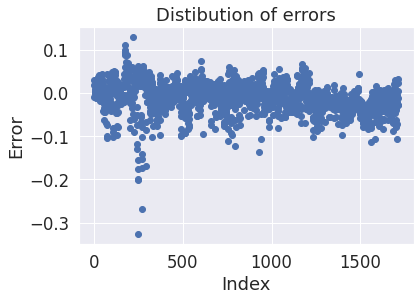

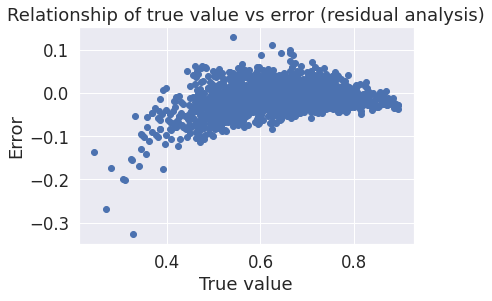

In [ ]:
pred = linreg.predict(val_X)
errors = val_y - pred

plt.scatter(list(range(len(errors))),errors);
plt.title("Distibution of errors")
plt.ylabel('Error');
plt.xlabel('Index');
plt.show();

plt.scatter(pred,errors);
plt.title('Relationship of true value vs error (residual analysis)')
plt.ylabel('Error');
plt.xlabel('True value');
plt.show();

По графику остатков видим, что они не очень похожи на нормально распределенные, и также фильтр выбросов отработал недостаточно хорошо( Можем также проверить это с помощью теста на нормальность.

In [ ]:
check_normality(errors,'Errors')

Statistics=506.098, p=0.000
Гипотеза о нормальности выборки по признаку 'Errors'должна быть отклонена


Тест подтвердил сделанное предположение.

#Regularization

In [ ]:
lasso = Lasso(alpha=0.0001)
pipeline = Pipeline([('estimator', lasso)])
scores = evaluate_model(train_X, val_X, train_y, val_y, pipeline)
scores

# plot_importance(pipeline.named_steps['estimator'], train_X.columns)

,train_RMSE,train_R2,val_RMSE,val_R2
0,0.02413,0.956172,0.042006,0.894534


Видим, что модель немного переобучена, но в целом результат неплохой, попробуем оптимизировать ее с помощью GridSearchCV

In [ ]:
parameters = {'alpha': [1e-15,1e-10,1e-8,1e-4,1e-2,1,5,10,20]}
lasso_regressor=GridSearchCV(lasso,parameters,scoring='r2',cv=TimeSeriesSplit(5))
lasso_regressor.fit(train_X,train_y)
# lasso_regressor.predict(val_X)
print(lasso_regressor.best_params_)
print(lasso_regressor.best_score_)


/usr/local/lib/python3.6/dist-packages/sklearn/linear_model/_coordinate_descent.py:476: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 0.16746590776077652, tolerance: 0.0017284015528613878
  positive)
/usr/local/lib/python3.6/dist-packages/sklearn/linear_model/_coordinate_descent.py:476: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 0.007515426731065311, tolerance: 0.003274871085791817
  positive)
/usr/local/lib/python3.6/dist-packages/sklearn/linear_model/_coordinate_descent.py:476: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 0.006812770162098913, tolerance: 0.0017284015528613878
  positive)
/usr/local/lib/python3.6/dist-packages/sklearn/linear_model/_coordinate_descent.py:476: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Dualit

{'alpha': 1e-08}
0.9340175417574222


/usr/local/lib/python3.6/dist-packages/sklearn/linear_model/_coordinate_descent.py:476: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 0.010392357210350589, tolerance: 0.009118728231401745
  positive)


In [ ]:
lasso = Lasso(alpha=1e-08)
pipeline = Pipeline([('estimator', lasso)])
scores = evaluate_model(train_X, val_X, train_y, val_y, pipeline)
scores

/usr/local/lib/python3.6/dist-packages/sklearn/linear_model/_coordinate_descent.py:476: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 0.010392357210350589, tolerance: 0.009118728231401745
  positive)


,train_RMSE,train_R2,val_RMSE,val_R2
0,0.023192,0.959514,0.037294,0.91687


Нам удалось улучшить немного модель, но в целом она почти не изменилась.

Посмотрим на важность признаков

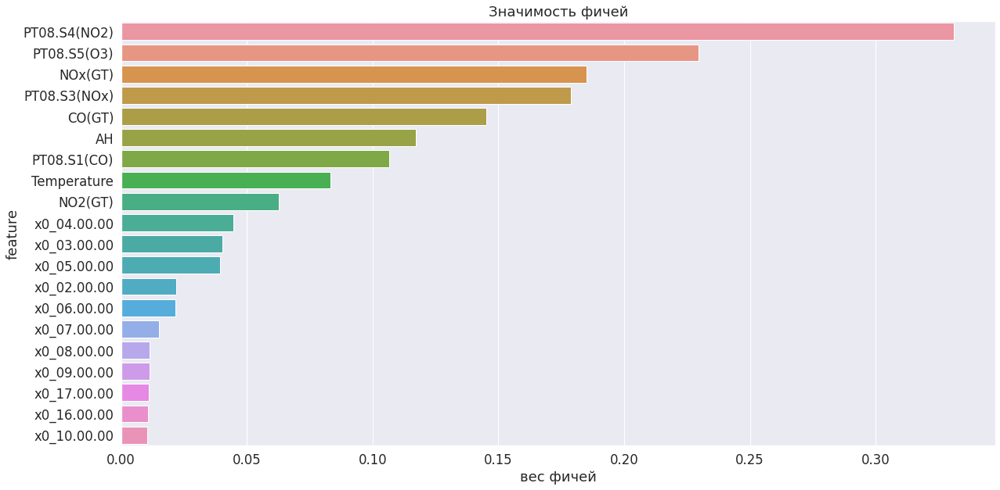

In [ ]:
plot_importance(lasso,prepared_data1_log.drop('Target',axis=1).columns)

Видим, что наиболее важные фичи, это 'PT08.S4(NO2)', 'PT08.S5(O3)','PT08.S3(NOx)', 'NOx(GT)'. И совсем малую значимость имеют переменные времени. Давайте оставим только Описанные выше фичи и посмотрим на результат.

In [ ]:
prepared_data1_log_2 = prepared_data1_log[[ 'PT08.S4(NO2)', 'PT08.S5(O3)','PT08.S3(NOx)', 'NOx(GT)','Target']]
target1 = prepared_data1_log['Target'].values
train_X, val_X, train_y, val_y = train_test_split(prepared_data1_log_2.drop(['Target'],
                                                            axis=1), 
                                                  target1, 
                                                  random_state=SEED, 
                                                  shuffle=False, 
                                                  test_size = 0.2)
lasso = Lasso(alpha=1e-08)
pipeline = Pipeline([('estimator', lasso)])
scores = evaluate_model(train_X, val_X, train_y, val_y, pipeline)
scores

,train_RMSE,train_R2,val_RMSE,val_R2
0,0.038307,0.889539,0.048913,0.857


Как видим, мы снизили переобучение, но при этом потеряли в качестве( Оставим только первые 8 признаков

In [ ]:
prepared_data1_log_2 = prepared_data1_log[[ 'PT08.S4(NO2)', 'PT08.S5(O3)','PT08.S3(NOx)', 'NOx(GT)','Target','CO(GT)','AH','Temperature','PT08.S1(CO)']]
target1 = prepared_data1_log['Target'].values
train_X, val_X, train_y, val_y = train_test_split(prepared_data1_log_2.drop(['Target'],
                                                            axis=1), 
                                                  target1, 
                                                  random_state=SEED, 
                                                  shuffle=False, 
                                                  test_size = 0.2)
lasso = Lasso(alpha=1e-08)
pipeline = Pipeline([('estimator', lasso)])
scores = evaluate_model(train_X, val_X, train_y, val_y, pipeline)
scores

,train_RMSE,train_R2,val_RMSE,val_R2
0,0.025688,0.950329,0.04264,0.891325


Видим что качество выросло, но при этом переобучение также возросло, поэтому лучше будет оставить модель полученную на прошлом шаге.